<a href="https://colab.research.google.com/github/awangenh/teleconsultorias/blob/main/TFD8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![banner cnns ppgcc ufsc](http://www.lapix.ufsc.br/wp-content/uploads/2019/04/VC2.png)


<a href="https://colab.research.google.com/github/jakevdp/PythonDataScienceHandbook/blob/master/notebooks/01.00-IPython-Beyond-Normal-Python.ipynb"><img align="left"  src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in Colab" title="Open and Execute in Google Colaboratory"></a>&nbsp; &nbsp;<a href=""><img align="left" src="http://www.lapix.ufsc.br/wp-content/uploads/2019/04/License-CC-BY-ND-4.0-orange.png" alt="Creative Commons 4.0 License" title="Creative Commons 4.0 License"></a>&nbsp; &nbsp; <a href=""><img align="left" src="http://www.lapix.ufsc.br/wp-content/uploads/2019/04/Jupyter-Notebook-v.1.0-blue.png" alt="Jupyter Version" title="Jupyter Version"></a>&nbsp; &nbsp;<a href=""><img align="left"  src="http://www.lapix.ufsc.br/wp-content/uploads/2019/04/Python-v.3.7-green.png" alt="Python Version" title="Python Version"></a>

### Cloning the ***Computer Vision*** repository from a Git

If you're running this at your computer or using Google Colab but **not** using your Google Drive, this is the way to use these notebooks!

In [ ]:
# To clone from our personal Github mirror (may be out of sync):
!git clone https://github.com/awangenh/vision

In [ ]:
# To clone from UFSC's Institutional Gitlab (always the latest version):
!git clone https://codigos.ufsc.br/aldo.vw/vision

### Info on Jupyter Notebooks and Google Colab

Look here:
 * [LAPIX::Jupyter Notebooks na UFSC (Seminário para Professores do INE/UFSC em 2019.1)](http://www.lapix.ufsc.br/jupyter-notebooks-na-ufsc/)
 * [LAPIX::Como Importar Jupyter Notebooks de GitHub para Google Colab?](http://www.lapix.ufsc.br/ensino/como-importar-jupyter-notebooks-de-github-para-google-colab/)
 * [LAPIX::Deep Learning::Usando a Nuvem para seus Trabalhos](http://www.lapix.ufsc.br/ensino/visao/visao-computacionaldeep-learning/deep-learningintroducao-ao-novo-coneccionismo/deep-learningusando-nuvem-para-seus-trabalhos/)

# Teleconsultations (Teleconsultorias) and Referrals (TFDs) Notebook

This notebook was conceived to process Teleconsultations (*Teleconsultorias*) and Referrals (*TFD*) data from the *Santa Catarina State Integrated Telemedicine and Telehealth System - STT/SC*. It will load two .csv files:
* teleconsultorias.csv - a |@| separated text file with the teleconsultation interaction data
* TFDs.csv - a |@| separated text file with the referral data. Referrals can or cannot be the consequence of a teleconsultation.

The are two types of teleconsultations performed at the STT/SC:
* **teleconsultations for referral**, which are obligatory for the primary healthcare teams to be able to perform the referral of patients to several specialities. The *answer* can include the specification of a *clinical conduct* or references to the literature.
 *  **classificacao** = "Dúvidas clínicas sobre pacientes (Intenção de encaminhamento – Fluxos com Centrais de Regulação)"
* **teleconsultations for doubts**: interactions between primary care personnell and specialists in order o solve doubts and answer questions

### Teleconsultations

**Teleconsultation** refers to the electronic communication that happens between a clinician and patient for the purpose of diagnostic or therapeutic advice. It involves sharing of textual data, scans, documents and photographs to get information related to patient's health (MeSH (Medical Subject Headings)).

* Teleconsultation and Clinical Decision Making: a Systematic Review. Acta Inform Med. 2016 Jul 16; 24(4): 286–292. https://dx.doi.org/10.5455%2Faim.2016.24.286-292

# Data Loading with Pandas

## General Initializations

Always run this cell!

References:
* Module *pandas_profiling*: https://pandas-profiling.github.io/pandas-profiling/docs/

**Important:**
* This is running under Python 3.6

In [8]:
!pip install prettypandas
!pip install pandas_profiling
!pip install pydantic-settings

In [11]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

from datetime import datetime
from scipy import ndimage
import numpy as np
import cv2
from scipy import ndimage
from matplotlib import pyplot as plt
from ipywidgets import interact, interactive, fixed, interact_manual

import pandas as pd
import prettypandas as pp
# Isto abaixo está dando erro...tem que ver como arruma ou eliminar prettypandas...
import pydantic_settings
import pandas_profiling

import seaborn as sns

# Test if your notebook is running on Google Colab
# You'll use this when choosing between doing interaction via ipywidgets or not.
try:
    import google.colab
    _ON_COLAB = True
    # Codigo para montar o Google Drive
    from google.colab import drive
    drive.mount('/content/drive')
    my_path = '/content/drive/My Drive/data/'
except:
    _ON_COLAB = False
    my_path = '/home/awangenh/Documents/Pandas/'

print('Running on Google Colab = ', _ON_COLAB)

PydanticImportError: `BaseSettings` has been moved to the `pydantic-settings` package. See https://docs.pydantic.dev/2.7/migration/#basesettings-has-moved-to-pydantic-settings for more details.

For further information visit https://errors.pydantic.dev/2.7/u/import-error

In [ ]:
!pwd

/home/awangenh/Documents/Pandas


# Text Mining/NLP Initializations

*VERY Good:*

* https://medium.com/@viniljf/utilizando-processamento-de-linguagem-natural-para-criar-um-sumariza%C3%A7%C3%A3o-autom%C3%A1tica-de-textos-775cb428c84e
* https://estatsite.com/2019/05/03/introducao-ao-text-mining-com-python/
* [NLP for Beginners: Cleaning & Preprocessing Text Data](https://towardsdatascience.com/nlp-for-beginners-cleaning-preprocessing-text-data-ae8e306bef0f)

*Additional:*

* http://nltk.org/book
* https://medium.com/towards-artificial-intelligence/text-mining-in-python-steps-and-examples-78b3f8fd913b
* Examples for Portuguese Processing - http://www.nltk.org/howto/portuguese_en.html
* https://docs.huihoo.com/nltk/0.9.5/guides/portuguese_en.html

*To observe:*

* https://anaconda.org/conda-forge/wordcloud
* https://pypi.org/project/wordcloud/
* https://www.geeksforgeeks.org/heap-queue-or-heapq-in-python/
* https://docs.python.org/3.0/library/heapq.html


In [ ]:
# In order to run this notebook you'll have to install those below:
!conda install nltk
!conda install -c conda-forge wordcloud
!conda install beautifulsoup4

In [ ]:
import nltk
import nltk.corpus

from nltk.stem import RSLPStemmer

from nltk.tokenize import sent_tokenize

# Imports - Do it only once!
# nltk.download('punkt')
# nltk.download('rslp')
# nltk.download('stopwords')
# nltk.download('averaged_perceptron_tagger')
# nltk.download('floresta')
# nltk.download('mac_morpho')
# nltk.download('machado')
# nltk.download('wordnet')
# nltk.download('words')

from string import punctuation
# Import a dictionary that doesn't throw errors when a key isn't found
from collections import defaultdict
# Data structure to represent a priority queue
# We will use it to rank sentences
from heapq import nlargest

from nltk.tokenize import word_tokenize, sent_tokenize
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.probability import FreqDist
from nltk.stem import WordNetLemmatizer

from nltk.corpus import floresta
from nltk.corpus import machado

# Import HTML cleaner/converter
from bs4 import BeautifulStoneSoup
from bs4 import BeautifulSoup
import cgi

# Initializations
stemmer = RSLPStemmer()
stop_words = nltk.corpus.stopwords.words('portuguese')
# Include punctuation into the stopword list
stop_words = stop_words + list(punctuation)
stop_words = stop_words + ['\'\'', '\"\"', '\'', '\"', '``', '`', '\\n', 'p', '/p',
                           'ccedil', 'aacute','eacute','oacute','uacute', 'iacute', 'nbsp', 'br', 'span', '/span', 'otilde', 'atilde', 'div', '/div' ]
# Turn it into a set
stop_words_set = set(stop_words)

class text_color:
    PURPLE = '\033[95m'
    CYAN = '\033[96m'
    DARKCYAN = '\033[36m'
    BLUE = '\033[94m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    RED = '\033[91m'
    BOLD = '\033[1m'
    UNDERLINE = '\033[4m'
    END = '\033[0m'


In [ ]:
import spacy
import pt_core_news_sm
#nlp = spacy.load("pt_core_news_sm")
nlp = pt_core_news_sm.load()

In [ ]:
doc = nlp("nodulo tireoidiano")
print([(w.text, w.pos_, w.lemma_) for w in doc])

[('nodulo', 'NOUN', 'nodular'), ('tireoidiano', 'ADJ', 'tireoidiano')]


In [ ]:
stemmer
for token in "nódulo de tireóide".split():
    print(stemmer.stem(token))

nódul
de
tireóid


In [ ]:
type(stop_words)

list

In [ ]:
lemmatizer = WordNetLemmatizer()
print(lemmatizer.lemmatize("poliartralgia"))

poliartralgia


In [ ]:
# If you need more corpora, use this interactive tool...
nltk.download()

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


True

## Spellchecking

*  pip install pyspellchecker
* https://pypi.org/project/pyspellchecker/
* https://buildmedia.readthedocs.org/media/pdf/pyspellchecker/latest/pyspellchecker.pdf


* 1000x faster Spelling Correction - https://towardsdatascience.com/symspellcompound-10ec8f467c9b
* Build a spell-checker with word2vec data (with python) - https://medium.com/@thomasdecaux/build-a-spell-checker-with-word2vec-data-with-python-5438a9343afd
* Build a naive Article Spell-checker in 10 Lines of Python Code - https://hackernoon.com/build-a-naive-article-spell-checker-in-10-lines-of-python-code-b325a67f2c3



* correction(word): Returns the most probable result for the misspelled word
* candidates(word): Returns a set of possible candidates for the misspelled word


In [ ]:
# Standard English
from spellchecker import SpellChecker

# spell = SpellChecker()
# spell = SpellChecker(language='es')# Spanish dictionary
spell = SpellChecker(language='pt')# Portuguese dictionary


# If the words that you wish to check are long, it is recommended to reduce the distance to 1
# spell = SpellChecker(distance=1)  # set at initialization
# spell.distance = 2  # set the distance parameter back to the default
spell.distance = 2  # set the distance parameter back to the default

# find those words that may be misspelled
misspelled = spell.unknown(['tireóide', 'cronica', 'tireoidiano', 'insuficiencia','reumatóide'])

for word in misspelled:
    # Get the one `most likely` answer
    print('Chosen: ', spell.correction(word))

    # Get a list of `likely` options
    print('Candidates: ', spell.candidates(word))


# spell.word_frequency.load_text('Text to be parsed and added to the system')
# spell.word_frequency.load_words(['Text', 'to', 'be','added', 'to', 'the', 'system'])
# spell.word_frequency.add('Text')
# spell.word_frequency.load_dictionary('./path-to-my-word-frequency.json')
# spell.word_frequency.load_text_file('./path-to-my-text-doc.txt')

Chosen:  tiróide
Candidates:  {'tiróide'}
Chosen:  tireoidiano
Candidates:  {'tireoidiano'}
Chosen:  reumatóide
Candidates:  {'reumatóide'}
Chosen:  crónica
Candidates:  {'crónica', 'crônica'}
Chosen:  insuficiência
Candidates:  {'insuficiência'}


## ICD-10 Initializations

* Loading data downloaded from http://www.datasus.gov.br/cid10/V2008/cid10.htm

### Load Chapters

In [1]:
cid10_capitulos = pd.read_csv(my_path + 'CID10CSV/CID-10-CAPITULOS.CSV',
                   sep=';',
                   encoding="latin-1",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                   quotechar='"',                                   # should be redundant, line breaks are read wrong anyway
                   na_filter=False,                                 # Do not interpret empty fields as NaNs
                   #lineterminator = os.linesep,
                   quoting=1,
                   engine='python')                                 # should be redundant when using a separator larger than one character, but...

print('Number of ICD-10 chapters:', len(cid10_capitulos))
cid10_capitulos[:22]

NameError: name 'pd' is not defined

### Load CID-10-GRUPOS

In [2]:
def load_cid10_grupos():
    cid10_grupos = pd.read_csv(my_path + 'CID10CSV/CID-10-GRUPOS.CSV',
                       sep=';',
                       encoding="latin-1",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                       quotechar='"',                                   # should be redundant, line breaks are read wrong anyway
                       na_filter=False,                                 # Do not interpret empty fields as NaNs
                       #lineterminator = os.linesep,
                       quoting=1,
                       engine='python')                                 # should be redundant when using a separator larger than one character, but...

    print('Number of ICD-10 groups:', len(cid10_grupos))
    return cid10_grupos

cid10_grupos = load_cid10_grupos()
cid10_grupos

NameError: name 'pd' is not defined

### Load CID-0-CATEGORIAS

In [ ]:
def load_cid0_categorias():
    cid0_categorias = pd.read_csv(my_path + 'CID10CSV/CID-O-CATEGORIAS.CSV',
                       sep=';',
                       encoding="latin-1",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                       quotechar='"',                                   # should be redundant, line breaks are read wrong anyway
                       na_filter=False,                                 # Do not interpret empty fields as NaNs
                       #lineterminator = os.linesep,
                       quoting=1,
                       engine='python')                                 # should be redundant when using a separator larger than one character, but...

    print('Number of ICD-0 categories:', len(cid0_categorias))
    return cid0_categorias

cid0_categorias = load_cid0_categorias()
cid0_categorias

### Create a Dictionary of Medical Terms from the ICD-10 Chapter and Group Descriptions

In [ ]:
medical_dict = ''
for icd in cid10_grupos.index:
    descricao = cid10_grupos.loc[icd, 'DESCRICAO'].lower()
    medical_dict = medical_dict + descricao + ' '
for icd in cid10_capitulos.index:
    descricao = cid10_capitulos.loc[icd, 'DESCRICAO'].lower()
    medical_dict = medical_dict + descricao + ' '
for icd in cid0_categorias.index:
    descricao = cid0_categorias.loc[icd, 'DESCRICAO'].lower()
    medical_dict = medical_dict + descricao + ' '

for str in ['Capítulo I - ', 'Capítulo II - ','Capítulo III - ','Capítulo IV - ','Capítulo V - ','Capítulo VI - ','Capítulo VII - ','Capítulo VIII - ','Capítulo IX - ',
            'Capítulo X - ', 'Capítulo XI - ', 'Capítulo XII - ', 'Capítulo XIII - ', 'Capítulo XIV - ', 'Capítulo XV - ', 'Capítulo XVI - ', 'Capítulo XVII - ',
            'Capítulo XVIII - ', 'Capítulo XIX - ', 'Capítulo XX - ', 'Capítulo XXI - ', 'Capítulo XXII - ']:
    if str.lower() in medical_dict:
        medical_dict = medical_dict.replace(str.lower(), ' ')

for str in stop_words:
    if ' '+str+' ' in medical_dict:
        medical_dict = medical_dict.replace(' '+str+' ', ' ')

for str in ['\"', ',', '[', ']', '(', ')', '/']:
    if str in medical_dict:
        medical_dict = medical_dict.replace(str, '')

# It's actually a monster string
# This will print the first 2k characters...
medical_dict[:2000]

## DeCS Initalizations

DeCS (*Descritores em Ciências da Saúde*) is the official extended PAHO (Pan-American Health Organization) version of the NHS Message Exchange for Social Care and Health (MESH) ontology. DeCS exists in English, Spanish and Portuguese. The  sponsors are PAHO, WHO and BIREME (Latin-American and Caribbean Center for Health Sciences Information). It is hosted at the Federal University of São Paulo (UNIFESP).
* http://decs.bvs.br/
* https://digital.nhs.uk/services/message-exchange-for-social-care-and-health-mesh

The *definicao* and *anotacao* fields can be used to improve the corpus of medical expression in their context.

In [ ]:
DeCS_descritores = pd.read_csv(my_path + 'DeCS/descritores.csv',
                   sep='\|@\|',
                   # encoding="latin-1",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                   encoding="utf-8",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                   quotechar='\"',                                   # should be redundant, line breaks are read wrong anyway
                   na_filter=False,                                 # Do not interpret empty fields as NaNs
                   #lineterminator = os.linesep,
                   quoting=1,
                   engine='python')                                 # should be redundant when using a separator larger than one character, but...

print('Number of DeCS descriptors:', len(DeCS_descritores))
DeCS_descritores

Number of DeCS descriptors: 58600


,id,descritor,definicao,anotacao
0,A01.047.025.600.225,Saco de Douglas,Um saco ou recesso formado por uma prega do pe...,um saco formado por uma prega do peritônio; do...
1,A01.047.025.600.451.535,Mesocolo,Prega do peritônio pela qual o COLO liga-se à ...,doenças: coord como primário com DOENÇAS PERIT...
2,A01.047.025.600.451,Mesentério,Camada do peritônio que liga as vísceras abdom...,evite /irrig: prefira ARTÉRIAS MESENTÉRICAS ou...
3,A01.047.025.600.573,Omento,Dobra formada por duas camadas do peritônio qu...,doenças: coord como primário com DOENÇAS PERIT...
4,A01.047.025.600.678,Cavidade Peritoneal,Espaço recoberto pelo peritônio. É dividido em...,"células peritoneais"" = provavelmente CAVIDADE ..."
...,...,...,...,...
58595,Z01.782.815.890,Tonga,Um arquipélago na Polinésia no sudoeste do Oce...,um arquipélago na Polinésia
58596,Z01.782.815,Polinésia,Nome coletivo para as ilhas do Oceano Pacífico...,um grupo de ilhas no Pacífico central
58597,Z01.782,Ilhas do Pacífico,Ihas do Oceano Pacífico divididas em MICRONÉSI...,"inclui MELANÉSIA, MICRONÉSIA & POLINÉSIA: veja..."
58598,Z01,Localizações Geográficas,Todos os continetes e todos os países situados...,usado para pesquisa bibliográfica; Cat Z: não ...


### DeCS Synonim Tables

Provide and interesting thesaurus of medical expressions

In [ ]:
DeCS_sinonimos = pd.read_csv(my_path + 'DeCS/sinonimos.csv',
                   sep='\|@\|',
                   # encoding="latin-1",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                   encoding="utf-8",                              # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                   quotechar='\"',                                   # should be redundant, line breaks are read wrong anyway
                   na_filter=False,                                 # Do not interpret empty fields as NaNs
                   #lineterminator = os.linesep,
                   quoting=1,
                   engine='python')                                 # should be redundant when using a separator larger than one character, but...

print('Number of DeCS synonims:', len(DeCS_sinonimos))
DeCS_sinonimos

Number of DeCS synonims: 81966


,id_decs,sinonimo
0,D02.033.100.624.836,Dexpropanolol
1,D03.383.312,Tetraidrofuranos
2,D08.811.277.352.355.325.300.250,Endonucleases de Restrição Tipo I
3,D08.811.277.352.355.325.300.250,Enzimas de Restrição Tipo I
4,D08.811.277.352.355.325.300.250,DNase de Sítio Específico do Tipo I
...,...,...
81961,D02.033.100.624.748.420,ICYP
81962,D02.033.100.624.748,Prindolol
81963,D02.033.100.624.836,Propanolol
81964,D03.383.312.649.691,Nitrofural


### Create a List of DeCS Terms

To be used to enhance the spellchecking capabilities beyound the standard Portuguese terms of the spellchecker

In [ ]:
DeCS_dict = ''
for desc in DeCS_descritores.index:
    descricao = DeCS_descritores.loc[desc, 'descritor'].lower()
    DeCS_dict = DeCS_dict + descricao + ' '


for str in stop_words:
    if ' '+str+' ' in DeCS_dict:
        DeCS_dict = DeCS_dict.replace(' '+str+' ', ' ')

for str in ['\"', ',', '[', ']', '(', ')', '/']:
    if str in DeCS_dict:
        DeCS_dict = DeCS_dict.replace(str, '')

# It's actually a monster string
# This will print the first 2k characters...
DeCS_dict[:2000]

'saco douglas mesocolo mesentério omento cavidade peritoneal estomas peritoneais peritônio espaço retroperitoneal cavidade abdominal parede abdominal virilha canal inguinal umbigo abdome região lombossacral região sacrococcígea dorso glândulas mamárias humanas mamilos mama cotos amputação nádegas acetabularia tornozelo metatarso hallux dedos pé antepé humano calcanhar pé quadril joelho pernas coxas extremidade inferior braço axila cotovelo antebraço polegar dedos metacarpo punho mãos ombro extremidade superior extremidades orelha bochecha períneo mediastino sulfatiazóis queixo sobrancelhas pestanas pálpebras olho testa lábio boca nariz região parotídea face couro cabeludo fossa craniana anterior fossa craniana média fossa craniana posterior base crânio cabeça pescoço soalho pélvico pelve cavidade pleural cavidade torácica parede torácica tórax vísceras regiões corpo cartilagem orelha cartilagem aritenóide cartilagem cricóide epiglote cartilagem tireóidea cartilagens laríngeas cartilage

# Referrals (TFDs)

**Will NOT be used in this part of the study**

In [ ]:
TFDs = pd.read_csv('/home/awangenh/Documents/Pandas/TFDs3.csv',
                   sep='\|@\|',                                      # | characters must be escaped with \, @ characters must not
                   encoding="utf-8",                                 # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                   quotechar='"',                                    # should be redundant, line breaks are read wrong anyway
                   dtype={"cpf_paciente": str},                      # force interpretation of the CPF field as something different from a float
                   parse_dates=["data_pedido"],                      # Intepret the data_pedido column as a date
                   na_filter=False,                                  # Do not interpret empty fields as NaNs
                   engine='python')                                  # should be redundant whe using a separator larger than one character, but...

print('Number of TFD occurrences:', len(TFDs))
TFDs[:len(TFDs)]

Number of TFD occurrences: 1305


,id_tfd,numero_pedido,data_pedido,tipo_processo,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,situacao_paciente,procedimento_solicitado,diagnostico_inicial,cid10,sia_sih,sigtap
0,5050,"""7/2018""","""2018-12-08""","""Interestadual""",1324136,139,"""700609493705268""","""Tainara Oliveira da Silva Taques""","""Em tratamento""","""Transferência para referência em transplante ...","""Insuficiência Hepática""","""""","""""","""0303070072 - TRATAMENTO DE DOENCAS DO FIGADO"""
1,15502,"""371/15/18""","""2018-08-22""","""Interestadual""",1496892,70749787953,"""708601041797081""","""OSMAR ALVES DA ROSA""","""Em tratamento""","""TRANSPLANTE DE MEDULA OSSEA""","""LMC""","""C921 - Leucemia mielóide crônica""","""""","""0505010020 - TRANSPLANTE ALOGENICO DE CELULAS..."
2,15587,"""179/14/18""","""2018-08-21""","""Interestadual""",1486459,9245113973,"""702802144266763""","""MILENA SCHUCK WEITBRECHT""","""Em tratamento""","""Acompanhamento Fígado trasplantado ""","""Trasplante de Fígado""","""Z944 - Fígado transplantado""","""""",""""""
3,15647,"""005/2018""","""2018-08-23""","""Interestadual""",1496668,10481687947,"""701009844599698""","""GEYEL LEOVINO MENDES""","""Primeiro atendimento fora do domicílio""","""TRANSPLANTE DE MEDULA OSSEA""","""ANEMIA APLÁSTICA SEVERA""","""D618 - Outras anemias aplásticas especificadas""","""""","""0505010020 - TRANSPLANTE ALOGENICO DE CELULAS..."
4,15727,"""154/18""","""2018-08-22""","""Interestadual""",1496919,6326999001,"""706301769132075""","""BRUNA CRISTINA MILLER LIMBERGER""","""Primeiro atendimento fora do domicílio""","""INTERNAÇÃO HOSPITALAR ""","""NEUROPATIA HEREDITÁRIA ""","""G609 - Neuropatia hereditária e idiopática nã...","""""",""""""
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1300,28271,"""16907/18/19""","""2019-09-03""","""Interestadual""",1529118,2172370967,"""706001813455841""","""FATIMA FERREIRA SANDRINI FURLAN""","""Primeiro atendimento fora do domicílio""","""EXPLORAÇÃO DIAGNÓSTICA PELO VÍDEO-ELETROENCEF...","""EPILEPSIA DE BASE FOCAL""","""""","""""","""0211050091 - EXPLORACAO DIAGNOSTICA PELO VIDE..."
1301,28272,"""1860/17/19""","""2019-09-03""","""Interestadual""",1341970,460538918,"""702804612777666""","""VOLNEI SOUZA CARDOSO""","""Primeiro atendimento fora do domicílio""","""EXPLORAÇÃO DIAGNÓSTICA VIDEO ELETROENCEFALOGR...","""EPILEPSIA BASE FOCAL""","""G402 - Epilepsia e síndromes epilépticas sint...","""""","""0211050091 - EXPLORACAO DIAGNOSTICA PELO VIDE..."
1302,28273,"""276/18/19""","""2019-07-24""","""Interestadual""",1408839,9965477973,"""708008386255226""","""MARCIO DA CRUZ PAES""","""Em tratamento""","""CIRURGICO""","""EPILEPSIA DE BASE FOCAL""","""G402 - Epilepsia e síndromes epilépticas sint...","""""","""0403060036 - MICROCIRURGIA PARA LESIONECTOMIA..."
1303,28274,"""611/14/19""","""2019-09-06""","""Interestadual""",755054,2027563008,"""02027563008""","""ERICK BIANCO GONÇALVES MORALES""","""Em tratamento""","""CONSULTA MEDICA EM REABILITAÇÃO ANOMALIAS CRA...","""FENDA PALATINA/ LÁBIO LEPORINO""","""Q37 - Fenda labial com fenda palatina""","""""","""0301010072 - CONSULTA MEDICA EM ATENÇÃO ESPEC..."


In [ ]:
TFDs.dtypes

id_tfd                      int64
numero_pedido              object
data_pedido                object
tipo_processo              object
id_int_paciente             int64
cpf_paciente               object
cns_paciente               object
nome_paciente              object
situacao_paciente          object
procedimento_solicitado    object
diagnostico_inicial        object
cid10                      object
sia_sih                    object
sigtap                     object
dtype: object

### Generate a Profile Report of the Referrals (TFDs)

---



In [ ]:
profile_TFDs = TFDs.profile_report(style={'full_width':True},
                                   n_freq_table_max = 20,
                                   title='Profile Report of the Referrals (TFDs)')
profile_TFDs.to_file(output_file="profile_TFDs.html")
profile_TFDs

# Teleconsultations - Whole Dataset

First load everything and then process it!

### Linux .csv conversion code samples

I've already applied them....

In [ ]:
# Conversões básicas:
# Substituir quebras de linha por escape sequences '\n'
!sed -i ':a;N;$!ba;s/\n/\\n/g' Teleconsultorias4.csv
# Repor quebras de linha ao fim de campos
!sed -i 's/\"\\n/\"\n/g' Teleconsultorias4.csv

### References

* https://backreference.org/2009/12/23/how-to-match-newlines-in-sed/
* https://stackoverflow.com/questions/1251999/how-can-i-replace-a-newline-n-using-sed
* https://unix.stackexchange.com/questions/212925/using-sed-to-replace-special-characters

### Load Teleconsultations .csv, add extra columns: *tam_resposta, cid10_capitulo* and *cid10_grupo* and clean HTML tags

* *tam_resposta*: size, in characters, of the teleconsultation response text stored in *resposta*
* https://www.journaldev.com/23365/python-string-to-datetime-strptime

In [ ]:
def load_teleconsultorias():
    teleconsultorias = pd.read_csv('/home/awangenh/Documents/Pandas/Teleconsultorias5.csv',
                       sep='\|@\|',                                      # | characters must be escaped with \, @ characters must not
                       encoding="utf-8",                                 # guarantee that João is read as such ad not as Joao or as some strange ASCII combination
                       quotechar='"',                                    # should be redundant, line breaks are read wrong anyway
                       #dtype={"cpf_paciente": str, "id_int_paciente": str},                      # force interpretation of the CPF field as something different from a float
                       #dtype={"cpf_paciente": str},                      # force interpretation of the CPF field as something different from a float
                       parse_dates=["data_solicitacao"],                      # Intepret the data_pedido column as a date
                       na_filter=False,                                  # Do not interpret empty fields as NaNs
                       #lineterminator = os.linesep,
                       quoting=1,
                       engine='python')                                  # should be redundant when using a separator larger than one character, but...

    print('Number of Teleconsulting occurrences:', len(teleconsultorias))
    return teleconsultorias

# Helper functions for ICD-10

def find_chapter(cid10):
    for icd in cid10_capitulos.index:
        low = cid10_capitulos.loc[icd, 'CATINIC']
        high = cid10_capitulos.loc[icd, 'CATFIM']
        if cid10 >= low and cid10 <= high:
            return cid10_capitulos.loc[icd, 'DESCRABREV']

def find_group(cid10):
    for icd in cid10_grupos.index:
        low = cid10_grupos.loc[icd, 'CATINIC']
        high = cid10_grupos.loc[icd, 'CATFIM']
        if cid10 >= low and cid10 <= high:
            return cid10_grupos.loc[icd, 'DESCRABREV']


def process_cid10_and_tam_resposta(teleconsultorias):
    print('Initialize the new tam_resposta column with zeroes')
    teleconsultorias['tam_resposta'] =  0
    print('Initialize the new cid10_capitulo and cid10_grupo columns with blanks')
    teleconsultorias['cid10_capitulo'] =  '  '
    teleconsultorias['cid10_grupo'] =  '  '

    print('Traverse the dataframe and:\n\t- clean HTML data\n\t- calculate the size of each response field\n\t- find ICD-10 chapter and group')
    for t in teleconsultorias.index:
        # print('Clean assunto from HTML tags and lowercase everything')
        clean = BeautifulSoup(teleconsultorias.loc[t, 'assunto']).get_text().lower()
        clean = clean.replace('\\n', ' ')
        # print('Remove all whitespace characters from assunto: space, tab, newline, return, formfeed')
        clean = " ".join(clean.split())
        teleconsultorias.loc[t, 'assunto'] = clean
        # print('Clean resposta from HTML tags and lowercase everything')
        clean = BeautifulSoup(teleconsultorias.loc[t, 'resposta']).get_text().lower()
        clean = clean.replace('\\n', ' ')
        # Remove all whitespace characters: space, tab, newline, return, formfeed
        clean = " ".join(clean.split())
        teleconsultorias.loc[t, 'resposta'] = clean
        # print('Clean pergunta from HTML tags and lowercase everything')
        clean = BeautifulSoup(teleconsultorias.loc[t, 'pergunta']).get_text().lower()
        clean = clean.replace('\\n', ' ')
        # print('Remove all whitespace characters from pergunta: space, tab, newline, return, formfeed')
        clean = " ".join(clean.split())
        teleconsultorias.loc[t, 'pergunta'] = clean

        # print('Calculate the size of each response field')
        teleconsultorias.loc[t, 'tam_resposta'] = len(teleconsultorias.loc[t, 'resposta'])

        # print('Find ICD-10 chapter and group')
        cid10 = teleconsultorias.loc[t, 'cid10']
        if len(cid10) == 2:
            # no cid10
            cid10_capitulo = 'n/i'  # ICD-1o not indicated
            cid10_grupo = 'n/i'     # ICD-1o not indicated
        else:
            # some cid10...
            cid10 = cid10[1:4]
            cid10_capitulo = find_chapter(cid10)
            cid10_grupo = find_group(cid10)
        teleconsultorias.loc[t, 'cid10_capitulo'] = cid10_capitulo
        teleconsultorias.loc[t, 'cid10_grupo'] = cid10_grupo

    return teleconsultorias

# Convert Date and Time Strings from the Database to *datetime* Objects
def convert_data_solicitacao(teleconsultorias):
    print('Traverse the dataframe and convert the date-time string to a datetime object')
    for t in teleconsultorias.index:
        data = teleconsultorias.loc[t, 'data_solicitacao']
        teleconsultorias.loc[t, 'data_solicitacao'] = datetime.strptime(data, '\"%Y-%m-%d %H:%M:%S.%f\"')

    return teleconsultorias

### Teleconsultorias Initializations and Conversions

* Call everything above and process

In [ ]:
def teleconsultorias_initializations_and_conversions():
    teleconsultorias = load_teleconsultorias()
    teleconsultorias = process_cid10_and_tam_resposta(teleconsultorias)
    teleconsultorias = convert_data_solicitacao(teleconsultorias)
    return teleconsultorias

teleconsultorias = teleconsultorias_initializations_and_conversions()
teleconsultorias[:30]

Number of Teleconsulting occurrences: 30901
Initialize the new tam_resposta column with zeroes
Initialize the new cid10_capitulo and cid10_grupo columns with blanks
Traverse the dataframe and:
	- clean HTML data
	- calculate the size of each response field
	- find ICD-10 chapter and group
Traverse the dataframe and convert the date-time string to a datetime object


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,...,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
0,46682,"""Assíncrona""",2018-08-21 14:30:39.826752,1494912,,"""705202483909977""","""MARIA SOUZA DOS SANTOS""","""curativo maria souza santos ""","""Dúvidas clínicas gerais""","""S - Pele""",...,"""""","""boa tarde enfª michely, anexo requisição de m...","""""","""""","""""","""""","""""",486,n/i,n/i
1,46683,"""Assíncrona""",2018-08-21 14:31:12.923861,1494925,,"""700506951428360""","""DONIZETE MATOS DE SOUZA ""","""diabete tipo 2 não controlada ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""E10 - Diabetes mellitus insulino-dependente""","""encaminhar o paciente.""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",24,IV. Doenças endócrinas nutricionais e metaból...,Diabetes mellitus
2,46684,"""Assíncrona""",2018-08-21 14:31:42.910268,1494951,,"""700802425260487""","""MARIA SONIA BATISTA NUNES""","""dor crõnica em ambas articulações coxo femora...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar a paciente c...","""""","""""","""""","""""","""""",185,n/i,n/i
3,46685,"""Assíncrona""",2018-08-21 16:20:16.503935,1495118,,"""700500582463157""","""ELIAS EDROS LAUREANO""","""orientaçao pte nefrectomizado rim dir com alt...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Nefrologia Adulto (Regulação Estadual)""",...,"""""","""prezado colega de acordo com protocolo da reg...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",174,n/i,n/i
4,46687,"""Assíncrona""",2018-08-21 16:25:03.411154,1495003,85372900920,"""""","""EVELINA KOWASKI""","""evelina kowaski""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""""",""" os melhores candidatos a cirurgia são aquele...","""""","""""","""""","""""","""""",442,n/i,n/i
5,46689,"""Assíncrona""",2018-08-21 16:26:30.581531,1495011,,"""106411110850001""","""NADIR ELIZABET CARDOSO""","""nadir elizabet cardoso - ortopedia""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar a paciente c...","""Satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Não se aplica""","""Não se aplica""",185,n/i,n/i
6,46692,"""Assíncrona""",2018-08-21 16:29:57.039948,1495041,,"""702003345382688""","""CLAUDETE DO AMARAL PEREIRA""","""sra. claudete do amaral pereira""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""""","""encaminhar ao hemosc""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",22,n/i,n/i
7,46693,"""Assíncrona""",2018-08-21 16:30:45.403835,1495045,,"""700800439240783""","""JUCENIR FRANCO""","""paciente com dm tipo 2 ha 5 anos""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""""","""para associar outro antidiabético oral, não e...","""""","""""","""""","""""","""""",307,n/i,n/i
8,46698,"""Assíncrona""",2018-08-21 16:45:13.410178,1495079,,"""898.0029.2391.2952""","""LETICIA APARECIDA GONÇALVES DE CASTRO MESNERO...","""enxaqueca com aura / cisto pineal""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""",...,"""""","""prezado dr. bruno. cistos pineais assintomáti...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não""",1069,n/i,n/i
9,46699,"""Assíncrona""",2018-08-21 16:46:21.243840,1495083,,"""705602412711410""","""FLAV

In [ ]:
teleconsultorias.dtypes

id_teleconsultoria                                    int64
tipo                                                 object
data_solicitacao                                     object
id_int_paciente                                       int64
cpf_paciente                                         object
cns_paciente                                         object
nome_paciente                                        object
assunto                                              object
classificacao                                        object
especificacao                                        object
detalhamento                                         object
pergunta                                             object
data_resposta                                        object
cid10                                                object
resposta                                             object
satisfacao_geral                                     object
atendimento_duvida_principal            

### Generate a Profile Report of the Teleconsultings Dataframe

* Which additional kwargs: https://github.com/pandas-profiling/pandas-profiling/blob/master/pandas_profiling/config_default.yaml

In [ ]:
profile_teleconsultorias = teleconsultorias.profile_report(style={'full_width':True},
                                                           n_freq_table_max = 20,
                                                           title='Profile Report of the Teleconsultings')
profile_teleconsultorias.to_file(output_file="profile_teleconsultorias.html")
profile_teleconsultorias

## Perform Inner Joins (cross-referencing) between *TFDs* (Referrals) and *teleconsultorias* (Teleconsultings)

### Cross-Reference Teleconsultings and Referrals based upon *id_int_paciente* (always present)

In [ ]:
# Based upon id_int_paciente
mergedStuff = pd.merge(TFDs, teleconsultorias, on=['id_int_paciente'], how='inner')
print('Number of entries: ', mergedStuff.shape)
mergedStuff.head(16)

Number of entries:  (16, 33)


,id_tfd,numero_pedido,data_pedido,tipo_processo,id_int_paciente,cpf_paciente_x,cns_paciente_x,nome_paciente_x,situacao_paciente,procedimento_solicitado,...,detalhamento,pergunta,data_resposta,cid10_y,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria
0,17003,"""067/18""","""2018-09-24""","""Interestadual""",1301214,10611259982,"""700501707879257""","""JESSICA GARCIA BERNARDES""","""Primeiro atendimento fora do domicílio""","""""",...,"""88 - Epilepsia / N - Sistema nervoso""","""Paciente apresentava epilepsia de difícil con...","""2018-12-18 16:00:36.800196""","""R51 - Cefaléia""","""Prezado Dr. Rafael""","""Satisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Não se aplica"""
1,17368,"""017/15/18""","""2018-09-24""","""Interestadual""",1324682,32846702896,"""700701403976080""","""GISELI APARECIDA RIBEIRO DOS SANTOS SOARES""","""Em tratamento""","""ACOMPANHAMENTO CIRÚRGICO""",...,"""88 - Epilepsia / N - Sistema nervoso""","""Paciente com epilepsia desde 13 anos, submeti...","""2019-01-20 18:32:49.023636""","""G40 - Epilepsia""","""Prezado Dr. Rafael""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Sim""","""Sim"""
2,21236,"""2040/08/19""","""2019-01-25""","""Interestadual""",1603115,6208017947,"""702809102644162""","""DEBORA LINHARES""","""Em tratamento""","""CONSULTA E EXAMES""",...,"""88 - Epilepsia / N - Sistema nervoso""","""Paciente feminina, 15 anos de idade Epilepsia...","""2019-02-25 16:14:44.897686""","""G40 - Epilepsia""","""Acredito que possa ser encaminhada a neurolog...","""""","""""","""""","""""",""""""
3,21517,"""211/18-19""","""2019-02-01""","""Interestadual""",1609448,8669710927,"""707408032084477""","""CAIO GUSZAK CUNHA""","""Em tratamento""","""ACOMPANHAMENTO MULTIDISCIPLINAR""",...,"""99 - Outras doenças endocrinológica/metabólic...","""<p>Encaminhamento para especialista</p>\n<p>P...","""2019-07-05 09:25:18.824948""","""F64 - Transtornos da identidade sexual""","""<p>Caro colega, paciente transg&ecirc;nero de...","""Satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
4,21696,"""002/19""","""2019-01-23""","""Interestadual""",1601770,8153196901,"""709802090759799""","""BRUNA RIBEIRO PIMENTEL""","""Primeiro atendimento fora do domicílio""","""REDESIGNAÇÃO SEXUAL NO SEXO MASCULINO""",...,"""99 - Outras doenças endocrinológica/metabólic...","""Protocolo de hormonização no programa de tran...","""2019-05-14 17:21:21.279638""","""F64 - Transtornos da identidade sexual""","""Sugiro encaminhar para o ambulatório do munic...","""Satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
5,22800,"""177/14-19""","""2019-03-15""","""Interestadual""",1644340,9476765976,"""705000653928055""","""ALINE DA SILVA""","""Em tratamento""","""CONSULTA E EXAMES ESPECIALIZADOS""",...,"""86 - Hipotiroidismo/mixedema / T - Endócrino,...","""PAciente apresentando TSH alterado após tran...","""2019-04-22 14:38:18.008075""","""E038 - Outros hipotireoidismos especificados""","""caro colega grato pela dúvida \n\nprovavelmen...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não"""
6,22800,"""177/14-19""","""2019-03-15""","""Interestadual""",1644340,9476765976,"""705000653928055""","""ALINE DA SILVA""","""Em tratamento""","""CONSULTA E EXAMES ESPECIALIZADOS""",...,"""76 - Perturbações depressivas / P - Psicológico""","""Paciente com história de tentativa de suícidi...","""2019-05-17 10:31:33.263509""","""F322 - Episódio depressivo grave sem sintomas...","""Bom dia!\n\nInfelizmente pacientes que passam...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
7,22800,"""177/14-19""","""2019-03-15""","""Interestadual""",1644340,9476765976,"""705000653928055""","""ALINE DA SILVA""","""Em tratamento""","""CONSULTA E EXAMES ESPECIALIZADOS""",...,"""82 - Outras anemias NE / B - Sangue, órgãos h..

### Generate a Profile Report of the Cross-Reference Teleconsultings and Referrals based upon *id_int_paciente*

In [ ]:
profile_mergedStuff = mergedStuff.profile_report(style={'full_width':True},
                                                        n_freq_table_max = 20,
                                                        title='Profile Report of the Cross-Reference Teleconsultings and Referrals based upon id_int_paciente')
profile_mergedStuff.to_file(output_file="profile_mergedStuff.html")
profile_mergedStuff

### Failed Attempts

In [ ]:
# Based upon cns_paciente
mergedStuff2 = pd.merge(TFDs, teleconsultorias, on=['cns_paciente'], how='inner')
print('Number of entries: ', mergedStuff2.shape)
mergedStuff2.head(15)
# ...FOR SOME REASON, CREATES A LOT OF DUPLICATES FROM THE ENTRY WITH cns_paciente = '""'

Number of entries:  (77783, 33)


,id_tfd,numero_pedido,data_pedido,tipo_processo,id_int_paciente_x,cpf_paciente_x,cns_paciente,nome_paciente_x,situacao_paciente,procedimento_solicitado,...,detalhamento,pergunta,data_resposta,cid10_y,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria
0,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""90 - Hérnia de hiato /diafragmática / D - Apa...","""Conduta da paciente .""","""2018-08-21 16:33:33.968752""","""""","""\tOs melhores candidatos a cirurgia são aquel...","""""","""""","""""","""""",""""""
1,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""82 - Obesidade / T - Endócrino, metabólico e ...","""PCTE COM QUADRO DE OBESIDADE TENDO REDUZIDO P...","""2018-08-23 11:37:26.348394""","""I89 - Outros transtornos não-infecciosos dos ...","""caro colega , entendo sua duvida .\n\nporem n...","""""","""""","""""","""""",""""""
2,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""29 - Outros sinais/ sintomas do sangue/ siste...","""perdida de peso de 10 kg em 1 mes""","""2018-08-25 23:07:17.920123""","""""","""alteração do hemograma discreta, NÃO apresent...","""""","""""","""""","""""",""""""
3,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""14 - Sinais/sintomas dos rins / U - Aparelho ...","""pte com dispneia ao reposo ortopneia com edem...","""2018-08-29 09:28:58.554232""","""""","""Prezado Colega\n\nCom base nesta creatinina p...","""""","""""","""""","""""",""""""
4,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""99 - Outra doença do aparelho músculo-esquelé...","""Necessidade de avaliação especializada""","""2018-08-23 16:48:56.301416""","""""","""Boa Tarde Dr Karl, \n\nNão veio anexado o tra...","""""","""""","""""","""""",""""""
5,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""90 - Hérnia de hiato /diafragmática / D - Apa...","""PACIENTE COM DOENÇA DO REFLUXO, HA MAIS DE 6 ...","""2018-08-23 19:11:07.487131""","""""","""\tGostaria de ressaltar que nesse momento o d...","""""","""""","""""","""""",""""""
6,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""87 - Alterações funcionais estômago / D - Apa...","""Conduta clinica com esta paciente sim melhor...","""2018-08-23 19:33:42.096215""","""""","""A dispepsia pode ser dividida em dispepsia fu...","""""","""""","""""","""""",""""""
7,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""81 - Bócio / T - Endócrino, metabólico e nutr...","""CNS: 706209595448267\n \nPaciente iniciou com...","""2018-08-23 13:25:26.58611""","""""","""Este nódulo é realmente muito suspeito para c...","""""","""""","""""","""""",""""""
8,15729,"""046/18""","""2018-08-22""","""Interestadual""",1498220,,"""""","""MAYLA LEAL NUNES""","""Primeiro atendimento fora do domicílio""","""OFTALMOLGIA/ONCOLÓGIA""",...,"""86 - Hipotiroidismo/mixedema""","""HIPOTIREOIDISMO . DÚVIDA_ AJUSTE DA DOSE DO ...","""2018-08-29 09:33:22.369569""","""E03 - Outros hipotireoidismos""","""Bom dia Cezar. \nPelo que entendi, ela es

## Work with *teleconsultorias* without the entries where cns_paciente = '""'

In [ ]:
# Create a copy of the 'teleconsultorias' dataframe without the entries where cns_paciente = '""'
teleconsultorias_with_CNS = teleconsultorias[teleconsultorias.cns_paciente != '\"\"']
print('Number of entries: ', teleconsultorias_with_CNS.shape)
teleconsultorias_with_CNS.head(15)

Number of entries:  (27198, 20)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,detalhamento,pergunta,data_resposta,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria
0,46682,"""Assíncrona""","""2018-08-21 14:30:39.826752""",1494912,,"""705202483909977""","""MARIA SOUZA DOS SANTOS""","""curativo maria souza santos ""","""Dúvidas clínicas gerais""","""S - Pele""","""56 - Curativo/bandagem/compressão/tamponamento""","""em anexo \nCURATIVO MARIA SOUZA SANTOS""","""2018-08-28 17:13:11.366449""","""""","""Boa tarde Enfª Michely, \n\n\n\nAnexo requisi...","""""","""""","""""","""""",""""""
1,46683,"""Assíncrona""","""2018-08-21 14:31:12.923861""",1494925,,"""700506951428360""","""DONIZETE MATOS DE SOUZA ""","""diabete tipo 2 não controlada ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...","""89 - Diabetes insulino-dependente / T - Endóc...","""Diabetes insulino-dependente não controlada ""","""2018-08-23 13:41:34.086735""","""E10 - Diabetes mellitus insulino-dependente""","""Encaminhar o paciente.""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
2,46684,"""Assíncrona""","""2018-08-21 14:31:42.910268""",1494951,,"""700802425260487""","""MARIA SONIA BATISTA NUNES""","""DOR CRÕNICA EM AMBAS ARTICULAÇÕES COXO FEMORA...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...","""14 - Sinais/sintomas da coxa/perna / L - Sist...","""DOR E LIMITAÇÃO FUNCIONAL IPOTANTE EM AMBOS Q...","""2018-08-28 01:33:03.671022""","""""","""Prezada colega, favor encaminhar a paciente c...","""""","""""","""""","""""",""""""
3,46685,"""Assíncrona""","""2018-08-21 16:20:16.503935""",1495118,,"""700500582463157""","""ELIAS EDROS LAUREANO""","""Orientaçao pte nefrectomizado rim dir com alt...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Nefrologia Adulto (Regulação Estadual)""","""14 - Sinais/sintomas dos rins / U - Aparelho ...",""" \nSolicito orientação sobre a necessidade d...","""2018-08-22 10:23:35.483484""","""""","""Prezado Colega\n\nDe acordo com protocolo da ...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
5,46689,"""Assíncrona""","""2018-08-21 16:26:30.581531""",1495011,,"""106411110850001""","""NADIR ELIZABET CARDOSO""","""NADIR ELIZABET CARDOSO - ORTOPEDIA""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...","""17 - Sinais/sintomas do pé/dedos pé / L - Sis...","""Paciente com 75 anos de idade, com queixa de ...","""2018-08-28 01:35:30.646212""","""""","""Prezada colega, favor encaminhar a paciente c...","""Satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Não se aplica""","""Não se aplica"""
6,46692,"""Assíncrona""","""2018-08-21 16:29:57.039948""",1495041,,"""702003345382688""","""CLAUDETE DO AMARAL PEREIRA""","""Sra. Claudete do Amaral Pereira""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""","""29 - Outros sinais/ sintomas do sangue/ siste...","""Solicito autorização para encaminhar paciente...","""2018-08-25 23:00:12.001723""","""""","""encaminhar ao hemosc""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
7,46693,"""Assíncrona""","""2018-08-21 16:30:45.403835""",1495045,,"""700800439240783""","""JUCENIR FRANCO""","""paciente com dm tipo 2 ha 5 anos""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...","""89 - Diabetes insulino-dependente / T - Endóc...",""" paciente com diabete melitus ha 5 anos em...","""2018-08-23 13:36:20.825718""","""""","""Para associar outro antidiabético oral, não e...","""""","""""","""""","""""",""""""
8,46698,"""Assíncrona""","""2018-08-21 16:45:13.

### Cross-Reference Teleconsultings and Referrals based upon cns_paciente (where present)

In [ ]:
# Create an inner join between the two dataframes based upon cns_paciente
mergedStuff3 = pd.merge(TFDs, teleconsultorias_with_CNS, on=['cns_paciente'], how='inner')
print('Number of entries: ', mergedStuff3.shape)
mergedStuff3.head(20)

Number of entries:  (20, 33)


,id_tfd,numero_pedido,data_pedido,tipo_processo,id_int_paciente_x,cpf_paciente_x,cns_paciente,nome_paciente_x,situacao_paciente,procedimento_solicitado,...,detalhamento,pergunta,data_resposta,cid10_y,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria
0,17003,"""067/18""","""2018-09-24""","""Interestadual""",1301214,10611259982,"""700501707879257""","""JESSICA GARCIA BERNARDES""","""Primeiro atendimento fora do domicílio""","""""",...,"""88 - Epilepsia / N - Sistema nervoso""","""Paciente apresentava epilepsia de difícil con...","""2018-12-18 16:00:36.800196""","""R51 - Cefaléia""","""Prezado Dr. Rafael""","""Satisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Não se aplica"""
1,17368,"""017/15/18""","""2018-09-24""","""Interestadual""",1324682,32846702896,"""700701403976080""","""GISELI APARECIDA RIBEIRO DOS SANTOS SOARES""","""Em tratamento""","""ACOMPANHAMENTO CIRÚRGICO""",...,"""88 - Epilepsia / N - Sistema nervoso""","""Paciente com epilepsia desde 13 anos, submeti...","""2019-01-20 18:32:49.023636""","""G40 - Epilepsia""","""Prezado Dr. Rafael""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Sim""","""Sim"""
2,21225,"""170/10/19""","""2019-01-17""","""Interestadual""",1611697,92395341991,"""705407441194298""","""CRISTIAN DIOR DE SA CARDOSO""","""Em tratamento""","""CONSULTA PARA REABILITAÇÃO""",...,"""12 - Obstipação / D - Aparelho digestivo (e/o...","""Paciente TRM com fratura e luxação t9, parapl...","""2019-01-24 15:56:03.98322""","""R194 - Alteração do hábito intestinal""","""Com relação a seu paciente com constipação1, ...","""Satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Sim""","""Sim"""
3,21236,"""2040/08/19""","""2019-01-25""","""Interestadual""",1603115,6208017947,"""702809102644162""","""DEBORA LINHARES""","""Em tratamento""","""CONSULTA E EXAMES""",...,"""88 - Epilepsia / N - Sistema nervoso""","""Paciente feminina, 15 anos de idade Epilepsia...","""2019-02-25 16:14:44.897686""","""G40 - Epilepsia""","""Acredito que possa ser encaminhada a neurolog...","""""","""""","""""","""""",""""""
4,21517,"""211/18-19""","""2019-02-01""","""Interestadual""",1609448,8669710927,"""707408032084477""","""CAIO GUSZAK CUNHA""","""Em tratamento""","""ACOMPANHAMENTO MULTIDISCIPLINAR""",...,"""99 - Outras doenças endocrinológica/metabólic...","""<p>Encaminhamento para especialista</p>\n<p>P...","""2019-07-05 09:25:18.824948""","""F64 - Transtornos da identidade sexual""","""<p>Caro colega, paciente transg&ecirc;nero de...","""Satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
5,21696,"""002/19""","""2019-01-23""","""Interestadual""",1601770,8153196901,"""709802090759799""","""BRUNA RIBEIRO PIMENTEL""","""Primeiro atendimento fora do domicílio""","""REDESIGNAÇÃO SEXUAL NO SEXO MASCULINO""",...,"""99 - Outras doenças endocrinológica/metabólic...","""Protocolo de hormonização no programa de tran...","""2019-05-14 17:21:21.279638""","""F64 - Transtornos da identidade sexual""","""Sugiro encaminhar para o ambulatório do munic...","""Satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim"""
6,22800,"""177/14-19""","""2019-03-15""","""Interestadual""",1644340,9476765976,"""705000653928055""","""ALINE DA SILVA""","""Em tratamento""","""CONSULTA E EXAMES ESPECIALIZADOS""",...,"""86 - Hipotiroidismo/mixedema / T - Endócrino,...","""PAciente apresentando TSH alterado após tran...","""2019-04-22 14:38:18.008075""","""E038 - Outros hipotireoidismos especificados""","""caro colega grato pela dúvida \n\nprovavelmen...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não"""
7,22800,"""177/14-19""","""2019-03-15""","""Interestadual""",1644340,9476765976,"""705000653928055""","""ALINE DA SILVA""","""Em tratamento""","""CONSULTA E EXAMES ESPECIALIZADOS""",...,"""76 - Perturbações depressivas / P - Psicológico""","""Pa

### Generate a Profile Report of the Cross-Reference between  Teleconsultings and Referrals based upon *cns_paciente* (where present)

In [ ]:
# Generate a profile report.
# This time, only with the cns_paciente that have a value, it works!
profile_mergedStuff3 = mergedStuff3.profile_report(style={'full_width':True},
                                                          n_freq_table_max = 20,
                                                          title='Profile Report of the Cross-Reference Teleconsultings and Referrals based upon cns_paciente (where present)')
profile_mergedStuff3.to_file(output_file="profile_mergedStuff3.html")
profile_mergedStuff3

# Teleconsultations about Referrals

Teleconsultations where **classificacao** = "*Dúvidas clínicas sobre pacientes (Intenção de encaminhamento – Fluxos com Centrais de Regulação)*"

In [ ]:
# Create a copy of the 'teleconsultorias' dataframe with the entries where classificacao = "Dúvidas clínicas sobre pacientes (Intenção de encaminhamento – Fluxos com Centrais de Regulação)"
teleconsultorias_for_referral = teleconsultorias[teleconsultorias.classificacao == '\"Dúvidas clínicas sobre pacientes (Intenção de encaminhamento – Fluxos com Centrais de Regulação)\"']
print('Number of entries: ', teleconsultorias_for_referral.shape)
teleconsultorias_for_referral.head(20)

Number of entries:  (28478, 23)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,...,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
1,46683,"""Assíncrona""",2018-08-21 14:31:12.923861,1494925,,"""700506951428360""","""DONIZETE MATOS DE SOUZA ""","""diabete tipo 2 não controlada ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""E10 - Diabetes mellitus insulino-dependente""","""encaminhar o paciente.""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",24,IV. Doenças endócrinas nutricionais e metaból...,Diabetes mellitus
2,46684,"""Assíncrona""",2018-08-21 14:31:42.910268,1494951,,"""700802425260487""","""MARIA SONIA BATISTA NUNES""","""dor crõnica em ambas articulações coxo femora...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar a paciente c...","""""","""""","""""","""""","""""",185,n/i,n/i
3,46685,"""Assíncrona""",2018-08-21 16:20:16.503935,1495118,,"""700500582463157""","""ELIAS EDROS LAUREANO""","""orientaçao pte nefrectomizado rim dir com alt...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Nefrologia Adulto (Regulação Estadual)""",...,"""""","""prezado colega de acordo com protocolo da reg...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",174,n/i,n/i
4,46687,"""Assíncrona""",2018-08-21 16:25:03.411154,1495003,85372900920,"""""","""EVELINA KOWASKI""","""evelina kowaski""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""""",""" os melhores candidatos a cirurgia são aquele...","""""","""""","""""","""""","""""",442,n/i,n/i
5,46689,"""Assíncrona""",2018-08-21 16:26:30.581531,1495011,,"""106411110850001""","""NADIR ELIZABET CARDOSO""","""nadir elizabet cardoso - ortopedia""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar a paciente c...","""Satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Não se aplica""","""Não se aplica""",185,n/i,n/i
6,46692,"""Assíncrona""",2018-08-21 16:29:57.039948,1495041,,"""702003345382688""","""CLAUDETE DO AMARAL PEREIRA""","""sra. claudete do amaral pereira""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""""","""encaminhar ao hemosc""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",22,n/i,n/i
7,46693,"""Assíncrona""",2018-08-21 16:30:45.403835,1495045,,"""700800439240783""","""JUCENIR FRANCO""","""paciente com dm tipo 2 ha 5 anos""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""""","""para associar outro antidiabético oral, não e...","""""","""""","""""","""""","""""",307,n/i,n/i
8,46698,"""Assíncrona""",2018-08-21 16:45:13.410178,1495079,,"""898.0029.2391.2952""","""LETICIA APARECIDA GONÇALVES DE CASTRO MESNERO...","""enxaqueca com aura / cisto pineal""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""",...,"""""","""prezado dr. bruno. cistos pineais assintomáti...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não""",1069,n/i,n/i
9,46699,"""Assíncrona""",2018-08-21 16:46:21.243840,1495083,,"""705602412711410""","""FLAVIA FEREIRA DA SILVA ""","""flavia ferreira da silva dn: 22/12/1960""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Reumatologia Adulto (Regulação Estadual; Itaj...",...,"""""","""boa tarde dr cleiton, avaliando os exames de ...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""",""

### Create an Anonymized Version of the Teleconsultations about Referrals Dataframe

In [ ]:
# Simplify listing column names.....
col_names = ''
for col in teleconsultorias_for_referral.columns:
    col_names = col_names + '\"' + col + '\",'

print(col_names)

"id_teleconsultoria","tipo","data_solicitacao","id_int_paciente","cpf_paciente","cns_paciente","nome_paciente","assunto","classificacao","especificacao","detalhamento","pergunta","data_resposta","cid10","resposta","satisfacao_geral","atendimento_duvida_principal","evitou_encaminhamento","teleconsultor_sugeriu_encaminhamento","intencao_encaminhar_paciente_apos_teleconsultoria","tam_resposta","cid10_capitulo","cid10_grupo",


In [ ]:
# Anonymize
anonymized_teleconsultorias_for_referral = teleconsultorias_for_referral[["id_teleconsultoria","data_solicitacao","assunto","especificacao",
                                                                          "detalhamento","pergunta","data_resposta","cid10","resposta","satisfacao_geral",
                                                                          "atendimento_duvida_principal","evitou_encaminhamento","teleconsultor_sugeriu_encaminhamento",
                                                                          "intencao_encaminhar_paciente_apos_teleconsultoria","tam_resposta","cid10_capitulo","cid10_grupo"]]
print('Number of entries: ', anonymized_teleconsultorias_for_referral.shape)
anonymized_teleconsultorias_for_referral[:20]

Number of entries:  (28478, 17)


,id_teleconsultoria,data_solicitacao,assunto,especificacao,detalhamento,pergunta,data_resposta,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
1,46683,2018-08-21 14:31:12.923861,"""diabete tipo 2 não controlada ""","""Endocrinologia (Regulação Estadual; Joinville...","""89 - Diabetes insulino-dependente / T - Endóc...","""diabetes insulino-dependente não controlada ""","""2018-08-23 13:41:34.086735""","""E10 - Diabetes mellitus insulino-dependente""","""encaminhar o paciente.""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",24,IV. Doenças endócrinas nutricionais e metaból...,Diabetes mellitus
2,46684,2018-08-21 14:31:42.910268,"""dor crõnica em ambas articulações coxo femora...","""Ortopedia (Joinville; Jaraguá do Sul e região...","""14 - Sinais/sintomas da coxa/perna / L - Sist...","""dor e limitação funcional ipotante em ambos q...","""2018-08-28 01:33:03.671022""","""""","""prezada colega, favor encaminhar a paciente c...","""""","""""","""""","""""","""""",185,n/i,n/i
3,46685,2018-08-21 16:20:16.503935,"""orientaçao pte nefrectomizado rim dir com alt...","""Nefrologia Adulto (Regulação Estadual)""","""14 - Sinais/sintomas dos rins / U - Aparelho ...",""" solicito orientação sobre a necessidade de r...","""2018-08-22 10:23:35.483484""","""""","""prezado colega de acordo com protocolo da reg...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",174,n/i,n/i
4,46687,2018-08-21 16:25:03.411154,"""evelina kowaski""","""Gastroenterologia Adulto (Regulação Estadual)""","""90 - Hérnia de hiato /diafragmática / D - Apa...","""conduta da paciente .""","""2018-08-21 16:33:33.968752""","""""",""" os melhores candidatos a cirurgia são aquele...","""""","""""","""""","""""","""""",442,n/i,n/i
5,46689,2018-08-21 16:26:30.581531,"""nadir elizabet cardoso - ortopedia""","""Ortopedia (Joinville; Jaraguá do Sul e região...","""17 - Sinais/sintomas do pé/dedos pé / L - Sis...","""paciente com 75 anos de idade, com queixa de ...","""2018-08-28 01:35:30.646212""","""""","""prezada colega, favor encaminhar a paciente c...","""Satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Não se aplica""","""Não se aplica""",185,n/i,n/i
6,46692,2018-08-21 16:29:57.039948,"""sra. claudete do amaral pereira""","""Hematologia Adulto (Regulação Estadual)""","""29 - Outros sinais/ sintomas do sangue/ siste...","""solicito autorização para encaminhar paciente...","""2018-08-25 23:00:12.001723""","""""","""encaminhar ao hemosc""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",22,n/i,n/i
7,46693,2018-08-21 16:30:45.403835,"""paciente com dm tipo 2 ha 5 anos""","""Endocrinologia (Regulação Estadual; Joinville...","""89 - Diabetes insulino-dependente / T - Endóc...",""" paciente com diabete melitus ha 5 anos em us...","""2018-08-23 13:36:20.825718""","""""","""para associar outro antidiabético oral, não e...","""""","""""","""""","""""","""""",307,n/i,n/i
8,46698,2018-08-21 16:45:13.410178,"""enxaqueca com aura / cisto pineal""","""Neurologia Adulto (Regulação Estadual; Itajaí)""","""89 - Enxaqueca / N - Sistema nervoso""","""qual a conduta para cisto pineal evoluindo co...","""2018-08-24 10:42:17.027138""","""""","""prezado dr. bruno. cistos pineais assintomáti...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não""",1069,n/i,n/i
9,46699,2018-08-21 16:46:21.243840,"""flavia ferreira da silva dn: 22/12/1960""","""Reumatologia Adulto (Regulação Estadual; Itaj...","""88 - Artrite reumatóide/seropositiva / L - Si...","""pct dores cronicas em joelhos e braço há apro...","""2018-08-23 16:40:46.689222""","""""","""boa tarde dr cleiton, avaliando os exames de ...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",412,n/i,n/i
10,46700,2018-08-21 16

*Save Anonymized Dataframe as .csv and as .xls*

In [ ]:
!conda install openpyxl

In [ ]:
#import xlsxwriter
import openpyxl
anonymized_teleconsultorias_for_referral.to_excel("anonymized_teleconsultations_for_referral.xlsx") #, engine='xlsxwriter')

In [ ]:
anonymized_teleconsultorias_for_referral.to_csv("anonymized_teleconsultations_for_referral.csv", sep='|') #, engine='xlsxwriter')

### Generate a Profile Report of the Teleconsultations about Referrals

In [ ]:
# Generate a profile report.
# This time, where the patient was explicitly asked to be referred
profile_teleconsultorias_for_referral = teleconsultorias_for_referral.profile_report(style={'full_width':True},
                                                          n_freq_table_max = 20,
                                                          missing_diagrams = {'heatmap':True, 'dendrogram':True, 'matrix':True},
                                                          title='Profile Report of the Teleconsulting Cases where Primry Care asked for Referral')
profile_teleconsultorias_for_referral.to_file(output_file=my_path + "profile_teleconsultorias_for_referral.html")
profile_teleconsultorias_for_referral

### Create a vision of the 'teleconsultorias_for_referral' dataframe with the entries between 2018-10-01 and 2019-05-30

Solicitação da Cristina para uma apresentação....

In [ ]:
# Create a vision of the 'teleconsultorias_for_referral' dataframe with the entries between 2018-10-01 and 2019-05-30
d1 = datetime.strptime('2018-10-01 00:00:00.000000', '%Y-%m-%d %H:%M:%S.%f')
d2 = datetime.strptime('2019-05-30 00:00:00.000000', '%Y-%m-%d %H:%M:%S.%f')

teleconsultorias_for_referral_timeframe = teleconsultorias_for_referral[(teleconsultorias_for_referral.data_solicitacao >= d1) & (teleconsultorias_for_referral.data_solicitacao <= d2)]
print('Number of entries: ', teleconsultorias_for_referral_timeframe.shape)
teleconsultorias_for_referral_timeframe

Number of entries:  (16655, 23)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,...,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
2758,49954,"""Assíncrona""",2018-10-01 07:39:59.361187,1525027,77394194949,"""""","""CRISTINE NAZARE PANDINI ""","""parestesia membros superiores""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""",...,"""R202 - Parestesias cutâneas""","""acredito que possa ser encaminhada para avali...","""""","""""","""""","""""","""""",87,XVIII.Sint sinais e achad anorm ex clín e laborat,Sintom e sinais relat à pele e tecido subcutâneo
2760,49957,"""Assíncrona""",2018-10-01 09:02:04.727703,1254565,61315508915,"""709000824633812""","""JOSE PEREIRA DOS SANTOS""","""retorno devido aneurisma cerebral ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""",...,"""I671 - Aneurisma cerebral não-roto""","""conforme os protocolos de acesso da ses (http...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",294,IX. Doenças do aparelho circulatório,Doenças cerebrovasculares
2761,49958,"""Assíncrona""",2018-10-01 09:18:40.645098,1525162,,"""898003832675673""","""DARCIO PATERNO""","""darcio paterno - alteração renal""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Nefrologia Adulto (Regulação Estadual)""",...,"""N188 - Outra insuficiência renal crônica""","""paciente com função renal estável desde janei...","""""","""""","""""","""""","""""",146,XIV. Doenças do aparelho geniturinário,Insuficiência renal
2762,49959,"""Assíncrona""",2018-10-01 09:36:19.402206,1525183,,"""706009363139348""","""LUIZ ADOLFO TRALESKI""","""polineuropatia crônica""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""",...,"""G628 - Outras polineuropatias especificadas""","""o paciente pode ser encaminhado para avaliaçã...","""""","""""","""""","""""","""""",66,VI. Doenças do sistema nervoso,Polineuropatias e outr transt sist nerv perifé...
2763,49961,"""Assíncrona""",2018-10-01 09:40:47.579414,1525196,3953902903,"""700001199706803""","""CATARINA PEREIRA DE MELO""","""dor articular""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Reumatologia Adulto (Regulação Estadual; Itaj...",...,"""M255 - Dor articular""","""prezada dra mireya:""","""""","""""","""""","""""","""""",21,XIII.Doenças sist osteomuscular e tec conjuntivo,Artropatias
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30891,4174,"""Síncrona""",2018-10-30 15:49:54.569983,1548868,,"""706700249735420""","""DAVID EDWIGERS""","""anemia ferroprivs ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""""","""""","""Satisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Não""",2,n/i,n/i
30892,4177,"""Síncrona""",2018-11-12 14:08:21.640946,1558268,,"""898000125990059""","""RODRIGO DA CRUZ BATISTA""","""anemia falciforme""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""""","""""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Sim""","""Sim""",2,n/i,n/i
30894,4192,"""Síncrona""",2018-12-20 20:05:24.486972,1586553,11231312955,"""706005300710443""","""SABRINA TEREZA RAIMONDI MACHADO""","""nodulo em mama infantil""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""""","""""","""""","""""","""""","""""","""""",2,n/i,n/i
30895,4193,"""Síncrona""",2019-01-07 17:18:25.390013,1588406,4429369909,"""705407498713499""","""MARCIA PANEGALI""","""intenção de encaminhamento para avaliação e a...","""Dúvidas clínicas sobre pacie

## Pie Charts from Teleconsultations about Referrals

In [ ]:
# Create a list of colors (from iWantHue)
colors = ["#E13F29", "#D69A80", "#D63B59", "#AE5552", "#CB5C3B", "#EB8076", "#96624E"]
#add colors
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99']

In [ ]:
def group_lower_ranking_values(dataframe, column, percentile=60):
    # print(column)
    # Generate a series, indexed by 'especificacao' and containing the
    # value counts of each value 'especificacao' value, sorted by count
    series = dataframe[column].value_counts(sort=True)
    # print(series)
    # Calculate the 25th percentile, in order to use it as a cut level
    # for the category named 'Other'
    quantile = series.quantile(percentile/100)
    print(percentile, 'th percentile: ', quantile)
    # Convert the Series into a DataFrame
    df1 = series.to_frame()
    # Convert the index, which will be the string valiues of 'especificacao'
    # into a standard dataframe column, while generating a new numeric index
    df1.reset_index(level=0, inplace=True)
    df1.columns = [column, 'ocorrencias']
    # Traverse the dataframe and replace 'especificacao' by 'Other' every
    # time the count is less than the cut percentile
    for t in df1.index:
        occurrences = df1.loc[t, 'ocorrencias']
        if occurrences < quantile:
            df1.loc[t, column] = 'Outros'

    # Group rows using 'especificacao' as the reference and a sum() as the
    # operation to be performed on the other columns
    df2 = df1.groupby(column).sum()
    # groupby produced a hierarchical index. Let's
    # flatten it forcing a reindexing....
    # print(df2.reset_index())
    #Transform the DataFrame into a Series
    df3 = df2.squeeze()
    # Sort the series
    df4 = df3.sort_values(ascending=False)
    # print('\n', df4)
    return df4

**Set Colormaps**

* https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html

In [ ]:
colormaps = [
    # Perceptually Uniform Sequential
    'viridis', 'plasma', 'inferno', 'magma', 'cividis',
    # Sequential
    'YlOrBr', 'YlOrRd', 'OrRd', 'PuRd', 'RdPu', 'BuPu',
    # Miscellaneous
    'gist_rainbow', 'rainbow', 'jet', 'nipy_spectral', 'gist_ncar',
    # Qualitative
    'Pastel1', 'Pastel2', 'Paired', 'Accent'
]

### Did the Teleconsultant suggest Referral?

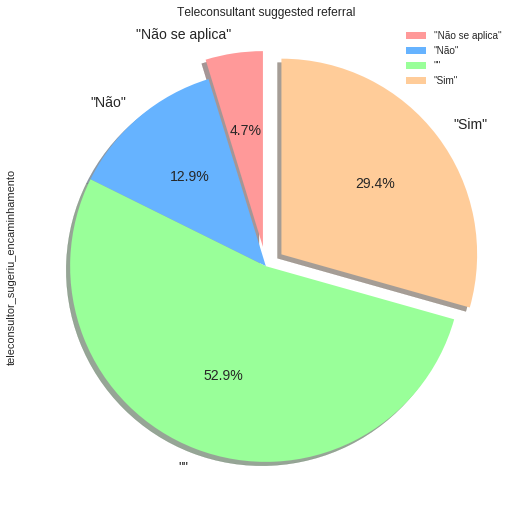

In [ ]:
plot = teleconsultorias_for_referral.teleconsultor_sugeriu_encaminhamento.value_counts(sort=False).plot.pie(y='teleconsultor_sugeriu_encaminhamento',
                                                                                                            title='Teleconsultant suggested referral',
                                                                                                            # with the percent listed as a fraction
                                                                                                            autopct='%1.1f%%',
                                                                                                            fontsize=14,
                                                                                                            # with no shadows
                                                                                                            shadow=True,
                                                                                                            # with colors
                                                                                                            colors=colors,
                                                                                                            # with the start angle at 90%
                                                                                                            startangle=90,
                                                                                                            # with one slide exploded out
                                                                                                            explode=(0.1, 0, 0, 0.1),
                                                                                                            legend = True,
                                                                                                            figsize=(9, 9))

### Does the Primary healthcare physician still intend to refer the patient?

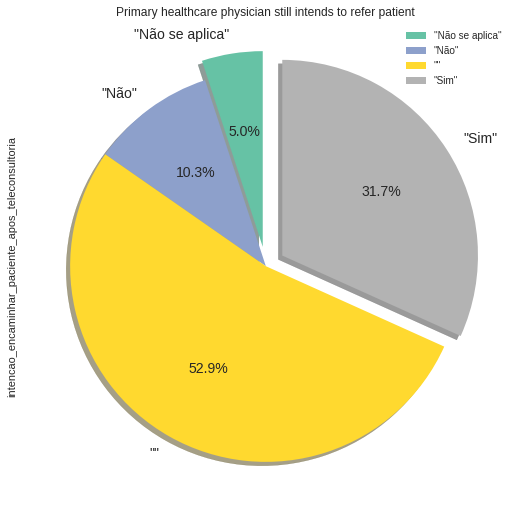

In [ ]:
plot = teleconsultorias_for_referral.intencao_encaminhar_paciente_apos_teleconsultoria.value_counts(sort=False).plot.pie(y='intencao_encaminhar_paciente_apos_teleconsultoria',
                                                                                                            title='Primary healthcare physician still intends to refer patient',
                                                                                                            # with the percent listed as a fraction
                                                                                                            autopct='%1.1f%%',
                                                                                                            fontsize=14,
                                                                                                            # with no shadows
                                                                                                            shadow=True,
                                                                                                            # with colors
                                                                                                            #colors=colors,
                                                                                                            cmap='Set2',
                                                                                                            # with the start angle at 90%
                                                                                                            startangle=90,
                                                                                                            # with one slide exploded out
                                                                                                            explode=(0.1, 0, 0, 0.1),
                                                                                                            legend = True,
                                                                                                            figsize=(9, 9))

### Where to was the Patient referred?

* *especificação* for referral teleconsultation patients

60 th percentile:  732.5999999999983


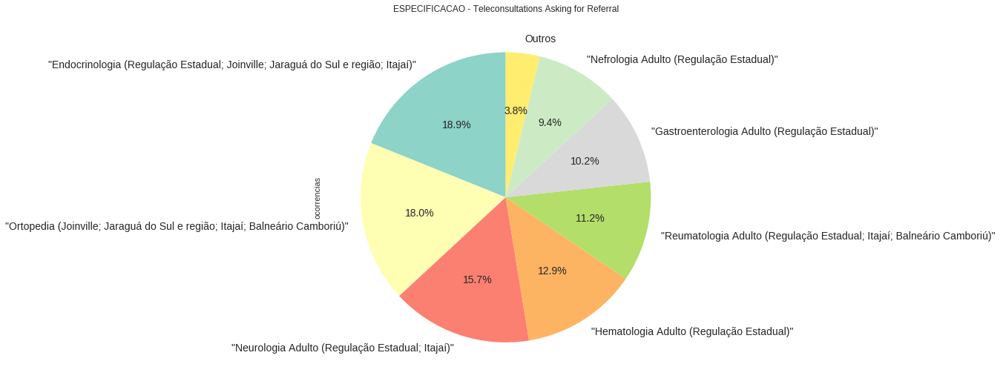

In [ ]:
df = group_lower_ranking_values(teleconsultorias_for_referral, 'especificacao', percentile=60)

plot = df.plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                    title='ESPECIFICACAO - Teleconsultations Asking for Referral',
                    # with the percent listed as a fraction
                    autopct='%1.1f%%',
                    fontsize=14,
                    # with no shadows
                    shadow=False,
                    # with colors
                    #colors=colors,
                    #cmap='Pastel2',
                    cmap='Set3',
                    # with the start angle at 90%
                    startangle=90,
                    # with one slide exploded out
                    #explode=(0.1, 0, 0, 0.1),
                    legend = False,
                    figsize=(9, 9))


### Distribution of ICD-10

50 th percentile:  522.0


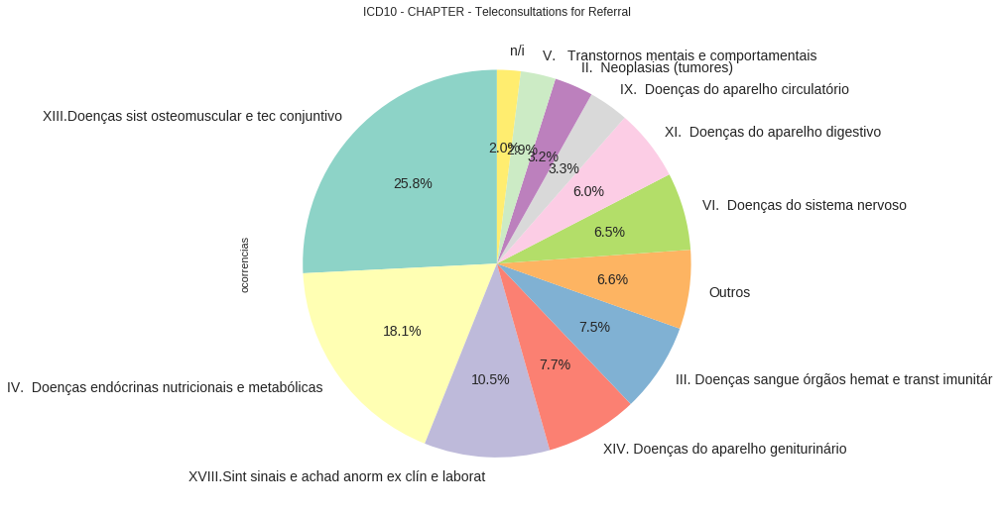

In [ ]:
df = group_lower_ranking_values(teleconsultorias_for_referral, 'cid10_capitulo', percentile=50)

plot = df.plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                    title='ICD10 - CHAPTER - Teleconsultations for Referral',
                    # with the percent listed as a fraction
                    autopct='%1.1f%%',
                    fontsize=14,
                    # with no shadows
                    shadow=False,
                    # with colors
                    #colors=colors,
                    cmap='Set3',
                    # with the start angle at 90%
                    startangle=90,
                    # with one slide exploded out
                    #explode=(0.1, 0, 0, 0.1),
                    legend = False,
                    figsize=(9, 9))



## ICPC-2/CIAP-2

International Classification of Primary Care (ICPC-2)/Classificação Internacional de Assistência Primária (CIAP-2) is a classification method for primary care encounters. It allows for the classification of the patient’s reason for encounter (RFE), the problems/diagnosis managed, primary or general health care interventions, and the ordering of the data of the primary care session in an episode of care structure.

In our database the IVCPC-2 metadata will always be organiized in the form ***NN - Component / A - Chapter***


* https://en.wikipedia.org/wiki/International_Classification_of_Primary_Care
* http://www.sbmfc.org.br/wp-content/uploads/media/file/CIAP%202/CIAP%20Brasil_atualizado.pdf
* http://medicinadefamiliabr.blogspot.com/2015/03/afinal-o-que-e-essa-tal-de-ciap-2.html

95 th percentile:  522.7999999999997


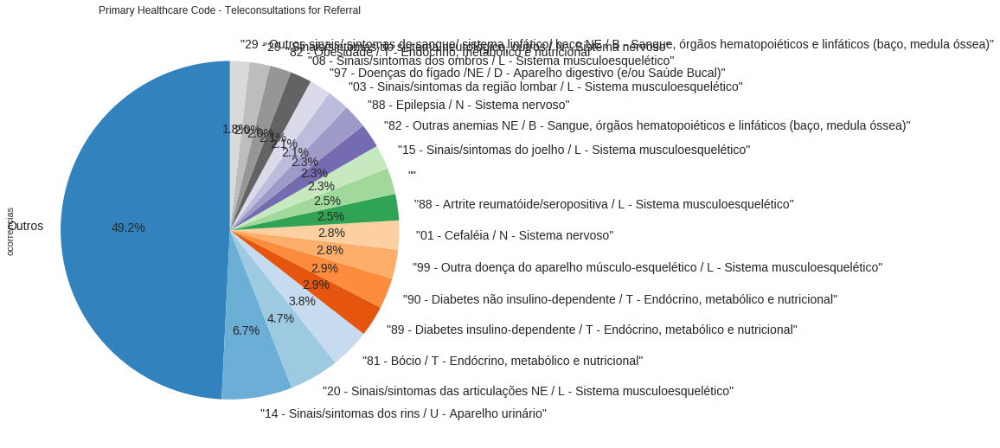

In [ ]:
df = group_lower_ranking_values(teleconsultorias_for_referral, 'detalhamento', percentile=95)

plot = df.plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                    title='Primary Healthcare Code - Teleconsultations for Referral',
                    # with the percent listed as a fraction
                    autopct='%1.1f%%',
                    fontsize=14,
                    # with no shadows
                    shadow=False,
                    # with colors
                    #colors=colors,
                    cmap='tab20c',
                    # with the start angle at 90%
                    startangle=90,
                    # with one slide exploded out
                    #explode=(0.1, 0, 0, 0.1),
                    legend = False,
                    figsize=(9, 9))



### Where to was the Patient referred when the teleconsultant advised against Referral

* 'intencao_encaminhar_paciente_apos_teleconsultoria' == "Sim" **AND** 'teleconsultor_sugeriu_encaminhamento' == "Não"

In [ ]:
# Create a copy of the 'teleconsultorias_for_referral' dataframe with only the entries where the teleconsultant suggested local treatment but the primary healthcare physician still
# intends to refer the patient
teleconsultorias_still_for_referral = teleconsultorias_for_referral[(teleconsultorias_for_referral['intencao_encaminhar_paciente_apos_teleconsultoria'] == "\"Sim\"") &
                                                                    (teleconsultorias_for_referral['teleconsultor_sugeriu_encaminhamento'] == "\"Não\"")]
print('Number of entries: ', teleconsultorias_still_for_referral.shape)
teleconsultorias_still_for_referral.head(10)

Number of entries:  (715, 23)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,...,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
18,46708,"""Assíncrona""","""2018-08-21 17:07:52.84992""",1495142,,"""700605953111761""","""ANDERSON ALIRIO DE OLIVEIRA ""","""anderson alirio de oliveira 35 anos ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""",...,"""""","""prezada dra. tuiane""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Não""","""Sim""",21,n/i,n/i
32,46724,"""Assíncrona""","""2018-08-21 22:57:44.445695""",1495286,,"""707805651499517""","""MARLETE APARECIDA DA SILVA BARBOSA""","""eructação noturna há 1 ano e meio""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""R14 - Flatulência e afecções correlatas""",""" trata-se de paciente com h pylori positivo, ...","""Satisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Sim""",3538,XVIII.Sint sinais e achad anorm ex clín e laborat,Sintom e sinais relat ao aparelho digest e abdome
49,46746,"""Assíncrona""","""2018-08-22 11:10:27.418433""",1495735,,"""703402196394500""","""CLEONICE FRANCISCA DA SILVA ALVES""","""hipotireoidismo""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""E03 - Outros hipotireoidismos""","""cara colega. a maior causa da dificuldade de ...","""Satisfeito(a)""","""Atendeu parcialmente""","""Sim""","""Não""","""Sim""",106,IV. Doenças endócrinas nutricionais e metaból...,Transtornos da glândula tireóide
88,46789,"""Assíncrona""","""2018-08-22 12:06:21.168038""",1495587,88776611949,"""704500654546420""","""ROSA MARIA DE SOUZA NASCIMENTO""","""rosa maria de souza nascimento""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Nefrologia Adulto (Regulação Estadual)""",...,"""""","""prezada colega com base nesta creatinina pode...","""Muito insatisfeito(a)""","""Não atendeu""","""Não se aplica""","""Não""","""Sim""",151,n/i,n/i
130,46838,"""Assíncrona""","""2018-08-22 16:11:01.460092""",1496202,,"""7026082833695342""","""ARAO DOMINGOS COELHO""","""membro superior ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""paciente com alterações degenerativas e tendi...","""Indiferente""","""Não atendeu""","""Não se aplica""","""Não""","""Sim""",81,n/i,n/i
141,46851,"""Assíncrona""","""2018-08-22 16:40:53.406748""",1496267,,"""705000618377757""","""KEOMA PANDINI""","""hemato... eritrocitose discreta sintomatica""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""D75 - Outras doenças do sangue e dos órgãos h...","""paciente apresentando policitemia desde 2015 ...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Não""","""Sim""",418,III. Doenças sangue órgãos hemat e transt imun...,Outras doenças do sangue e órgãos hematopoéticos
172,46892,"""Assíncrona""","""2018-08-23 12:45:22.25611""",1496716,,"""705102841705840""","""EULITA SCHUSLLER NASCIMENTO""","""bicitopenia, dor óssea, febre noturna""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""""","""apresenta anemia de doença crônica, leucócito...","""Indiferente""","""Atendeu parcialmente""","""Não""","""Não""","""Sim""",57,n/i,n/i
183,46906,"""Assíncrona""","""2018-08-23 12:50:52.667866""",1496837,,"""707603258053894""","""AMELIA SCHMIDT DA SILVA""","""nódulo de tireóide""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""E05 - Tireotoxicose [hipertireoidismo]""","""recomendo inicialmente confirmar o hipertireo...","""Mui

**Comment**: *Neurologia Adulto* recedes from the 3rd to the 7th position. Remaining destinations remain unchanged.

40 th percentile:  30.600000000000023


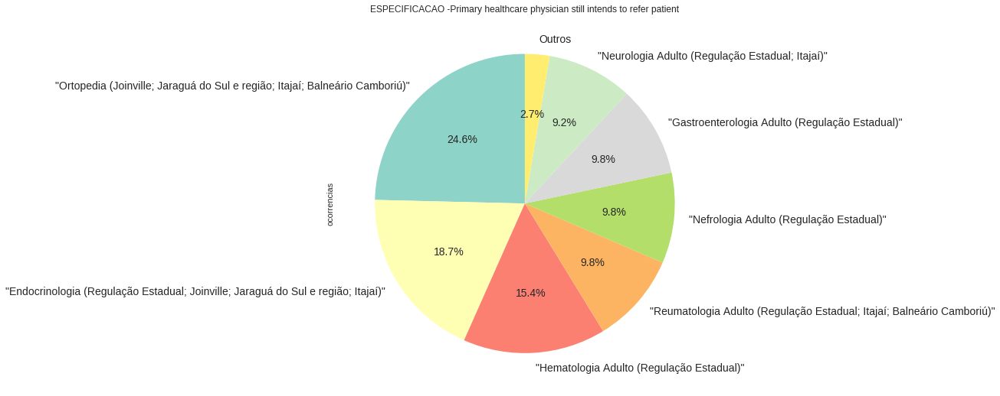

In [ ]:
df = group_lower_ranking_values(teleconsultorias_still_for_referral, 'especificacao', percentile=40)

plot = df.plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                    title='ESPECIFICACAO -Primary healthcare physician still intends to refer patient',
                    # with the percent listed as a fraction
                    autopct='%1.1f%%',
                    fontsize=14,
                    # with no shadows
                    shadow=False,
                    # with colors
                    #colors=colors,
                    # with the start angle at 90%
                    cmap='Set3',
                    startangle=90,
                    # with one slide exploded out
                    #explode=(0.1, 0, 0, 0.1),
                    legend = False,
                    figsize=(9, 9))

50 th percentile:  1650.0


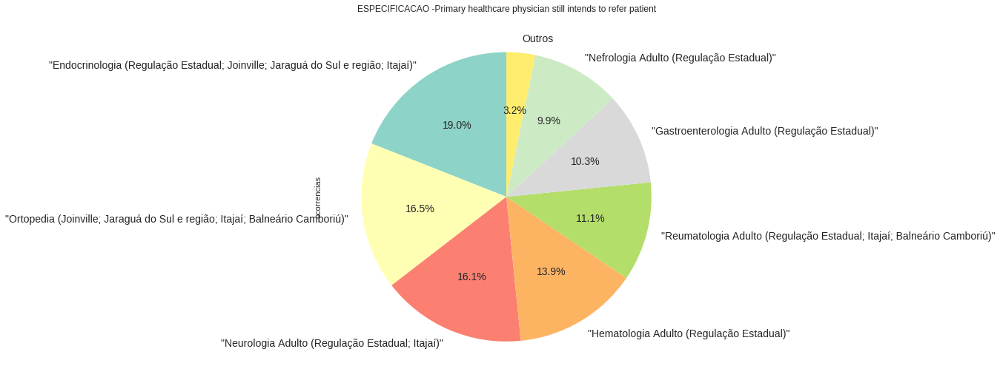

In [ ]:


df = group_lower_ranking_values(teleconsultorias_for_referral_timeframe, 'especificacao', percentile=50)

plot = df.plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                    title='ESPECIFICACAO -Primary healthcare physician still intends to refer patient',
                    # with the percent listed as a fraction
                    autopct='%1.1f%%',
                    fontsize=14,
                    # with no shadows
                    shadow=False,
                    # with colors
                    #colors=colors,
                    # with the start angle at 90%
                    cmap='Set3',
                    startangle=90,
                    # with one slide exploded out
                    #explode=(0.1, 0, 0, 0.1),
                    legend = False,
                    figsize=(9, 9))

65 th percentile:  23.0


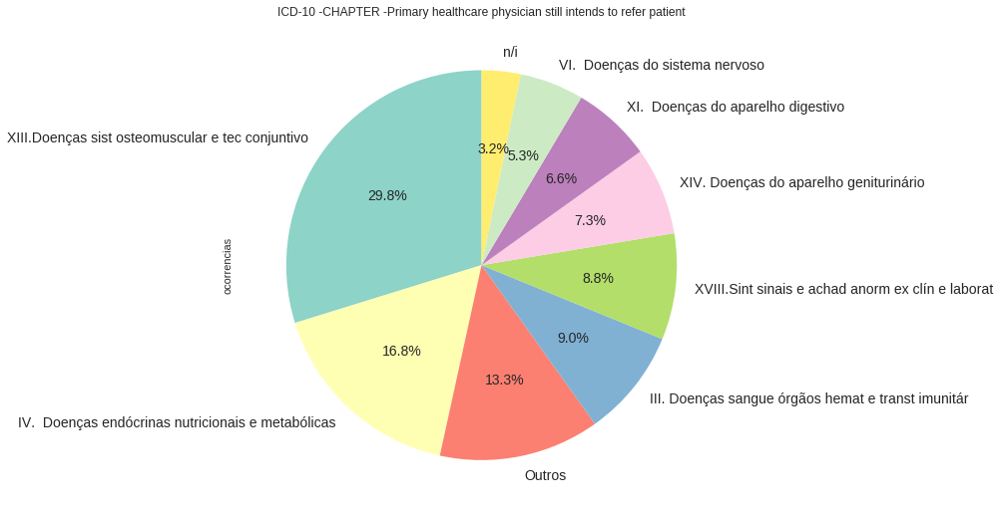

In [ ]:
df = group_lower_ranking_values(teleconsultorias_still_for_referral, 'cid10_capitulo', percentile=65)

plot = df.plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                    title='ICD-10 -CHAPTER -Primary healthcare physician still intends to refer patient',
                    # with the percent listed as a fraction
                    autopct='%1.1f%%',
                    fontsize=14,
                    # with no shadows
                    shadow=False,
                    # with colors
                    #colors=colors,
                    cmap='Set3',
                    # with the start angle at 90%
                    startangle=90,
                    # with one slide exploded out
                    #explode=(0.1, 0, 0, 0.1),
                    legend = False,
                    figsize=(9, 9))

In [ ]:
# Generate a profile report.
# This time, where the patient was explicitly asked to be referred
profile_teleconsultorias_still_for_referral = teleconsultorias_still_for_referral.profile_report(style={'full_width':True},
                                                          n_freq_table_max = 20,
                                                          title='Profile Report of the Teleconsulting Cases where Primry Care still asks for Referral after Teleconsultant denied')
profile_teleconsultorias_still_for_referral.to_file(output_file=my_path + "profile_teleconsultorias_still_for_referral.html")
profile_teleconsultorias_still_for_referral

## Cross-Tabulations from Teleconsultations about Referrals

### cid10 x especifcacao

In [ ]:
pd.crosstab(teleconsultorias_for_referral.cid10, teleconsultorias_for_referral.especificacao)

NameError: ignored

In [ ]:
fig, ax = plt.subplots(figsize=(10,150))         # figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.cid10, teleconsultorias_for_referral.especificacao),
            #cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            cmap="nipy_spectral",
            #cmap="Oranges",
            #annot=True,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_cid10_especificacao.png")

heatmap

In [ ]:
fig, ax = plt.subplots(figsize=(15,250))         # Sample figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.cid10, teleconsultorias_for_referral.especificacao),
            cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            #cmap="nipy_spectral",
            #cmap="Oranges",
            annot=True,
            annot_kws={"size": 7},
            linewidths=0.0,
            cbar=False,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_cid10_especificacao_values.png")

heatmap

### cid10_capitulo x especificacao

In [ ]:
fig, ax = plt.subplots(figsize=(10,9))         # figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.cid10_capitulo, teleconsultorias_for_referral.especificacao),
            #cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            #cmap="nipy_spectral",
            #cmap='jet',
            cmap='PuRd',
            #cmap='CMRmap',
            #cmap="Oranges",
            #annot=True,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_cid10_grande_grupo_especificacao.png")

heatmap

In [ ]:
fig, ax = plt.subplots(figsize=(15,250))         # Sample figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.cid10_capitulo, teleconsultorias_for_referral.especificacao),
            cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            #cmap="nipy_spectral",
            #cmap="Oranges",
            annot=True,
            annot_kws={"size": 7},
            #linewidths=0.0,
            #cbar=False,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_cid10_capitulo_especificacao_values.png")

heatmap

### cid10_grupo x especificacao

In [ ]:
fig, ax = plt.subplots(figsize=(10,30))         # figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.cid10_grupo, teleconsultorias_for_referral.especificacao),
            #cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            #cmap="nipy_spectral",
            cmap='jet',
            #cmap='PuRd',
            #cmap='CMRmap',
            #cmap="Oranges",
            #annot=True,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_cid10_grupo_especificacao.png")

heatmap

### Crosstab cid10_capitulo X detalhamento

In [ ]:
fig, ax = plt.subplots(figsize=(23,6))         # figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.cid10_capitulo, teleconsultorias_for_referral.detalhamento),
            #cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            #cmap="nipy_spectral",
            #cmap='jet',
            cmap='PuRd',
            #cmap='CMRmap',
            #cmap="Oranges",
            #annot=True,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_cid10_capitulo_detalhamento.png")

heatmap

### Crosstab especificacao X detalhamento

In [ ]:
fig, ax = plt.subplots(figsize=(23,6))         # figsize in inches

heatmap = sns.heatmap(pd.crosstab(teleconsultorias_for_referral.especificacao, teleconsultorias_for_referral.detalhamento),
            #cmap="YlGnBu",
            #cmap="magma",
            #cmap="Spectral",
            #cmap="nipy_spectral",
            #cmap='jet',
            cmap='PuRd',
            #cmap='CMRmap',
            #cmap="Oranges",
            #annot=True,
            ax=ax)

fig = heatmap.get_figure()
fig.savefig(my_path + "crosstab_especificacao_detalhamento.png")

heatmap

## Large Responses

*teleconsultorias_for_referral* dataframe with only the entries where th response is larger than 15,000 characters

In [ ]:
# Create a copy of the 'teleconsultorias_for_referral' dataframe with only the entries where th response is larger than 15,000 characters
teleconsultorias_for_referral_large_responses = teleconsultorias_for_referral[teleconsultorias_for_referral.tam_resposta > 10000]
print('Number of entries: ', teleconsultorias_for_referral_large_responses.shape)
teleconsultorias_for_referral_large_responses.head(15)

Number of entries:  (7, 23)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,...,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
8288,56232,"""Assíncrona""","""2018-12-13 11:54:20.769661""",1582162,1438821980,"""707002817322632""","""ENI MARTTA GUERRA""","""gastrite erosiva severa""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""K760 - Degeneração gordurosa do fígado não cl...","""a esteatose hepática é um termo genérico que ...","""""","""""","""""","""""","""""",13020,XI. Doenças do aparelho digestivo,Doenças do fígado
14857,63543,"""Assíncrona""","""2019-03-25 08:43:13.199085""",1647210,58004394949,"""12286516547""","""EDSON KUHL""","""solicitação de encaminhamento para avaliação ...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""K760 - Degeneração gordurosa do fígado não cl...","""seguem abaixo algumas considerações sobre o m...","""""","""""","""""","""""","""""",11155,XI. Doenças do aparelho digestivo,Doenças do fígado
19594,69090,"""Assíncrona""","""2019-05-16 11:49:33.715858""",1407145,,"""705808457549233""","""EDGARD CORDEIRO DE SOUZA""","""gastroenterologia edgard""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""K760 - Degeneração gordurosa do fígado não cl...","""lista de problemas: 1 - esôfago de barrett 2 ...","""""","""""","""""","""""","""""",17891,XI. Doenças do aparelho digestivo,Doenças do fígado
22902,73030,"""Assíncrona""","""2019-06-25 16:53:45.435293""",1725800,,"""702405043701223""","""VANILDA FREITAS ELIAS""","""epigastralgia há 4m sem melhora""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""K319 - Doenças do estômago e do duodeno, sem ...","""o tratamento com claritro - amoxicilina e ibp...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",10504,XI. Doenças do aparelho digestivo,"Doenças do esôfago, do estômago e do duodeno"
22932,73063,"""Assíncrona""","""2019-06-26 09:49:36.002379""",1726243,5599392996,"""706009849181749""","""PATRICIA AMARANTE""","""pangastrite h pylori positiva refratária""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""K29 - Gastrite e duodenite""","""jamais se deve utilizar o mesmo esquema para ...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Não se aplica""","""Sim""",13520,XI. Doenças do aparelho digestivo,"Doenças do esôfago, do estômago e do duodeno"
23907,74190,"""Assíncrona""","""2019-07-08 07:50:40.607304""",1735201,7804075249,"""704102236283950""","""MARIA SILVANA HACKE CALLEGARI""","""dispesias funcional +cisto hepatico simples r...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""R932 - Achados anormais de exames para diagnó...","""as lesões focais no fígado1 são frequentes e,...","""""","""""","""""","""""","""""",10419,XVIII.Sint sinais e achad anorm ex clín e laborat,"Achad anorm exam diag imagem estud função, s/diag"
30666,81751,"""Assíncrona""","""2019-09-11 15:38:03.978487""",1785925,,"""705002403171951""","""CLEBER MENDES REZIN""","""esofagite erosiva severa""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""",...,"""K210 - Doença de refluxo gastroesofágico com ...","""a presença de esofagite erosiva grau c na end...","""""","""""","""""","""""","""""",13258,XI. Doenças do aparelho digestivo,"Doenças do esôfago, do estômago e do duodeno"


In [ ]:
large_responses = teleconsultorias_for_referral_large_responses['resposta']
for response in large_responses:
    print(response)
    print('\n======================================================================================\n')

"a esteatose hepática é um termo genérico que se refere ao acúmulo de triglicerídeos no citoplasma de hepatócitos. o fígado gorduroso (esteatose hepática) é geralmente diagnosticado em indivíduos sem evidência clínica de doença hepática, após a identificação fortuita de níveis elevados de aminotransferases sérica ou como achado de ultrassonografia. as principais condições associadas à presença de esteatose hepática são doença hepática alcoólica e doença hepática gordurosa não alcoólica (dhena). a esteatose hepática também pode ocorrer devido a vários outros fatores etiológicos, incluindo o uso de medicamentos (como tamoxifeno e metotrexato) e toxinas (como tetracloreto de carbono e arsênico) e a presença de hepatite b e c crônica (mais comumente na infecção por hepatite c) e outras doenças metabólicas (como hemocromatose e doença de wilson)1. a esteatohepatite não alcoólica (ehna) é o nome dado às formas de dhena nas quais são encontrados graus variados de alterações degenerativas, ati

### Teleconsulting Cases actually suggested for Referral

* DataFrame name: *teleconsultorias_for_TFD*

In [ ]:
# Create a copy of the 'teleconsultorias' dataframe with the entries where teleconsultor_sugeriu_encaminhamento == '"Sim"'
teleconsultorias_for_TFD = teleconsultorias_for_referral[teleconsultorias_for_referral.teleconsultor_sugeriu_encaminhamento == '\"Sim\"']
print('Number of entries: ', teleconsultorias_for_TFD.shape)
teleconsultorias_for_TFD.head(15)

Number of entries:  (8366, 23)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,...,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria,tam_resposta,cid10_capitulo,cid10_grupo
1,46683,"""Assíncrona""","""2018-08-21 14:31:12.923861""",1494925,,"""700506951428360""","""DONIZETE MATOS DE SOUZA ""","""diabete tipo 2 não controlada ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Endocrinologia (Regulação Estadual; Joinville...",...,"""E10 - Diabetes mellitus insulino-dependente""","""encaminhar o paciente.""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",24,IV. Doenças endócrinas nutricionais e metaból...,Diabetes mellitus
3,46685,"""Assíncrona""","""2018-08-21 16:20:16.503935""",1495118,,"""700500582463157""","""ELIAS EDROS LAUREANO""","""orientaçao pte nefrectomizado rim dir com alt...","""Dúvidas clínicas sobre pacientes (Intenção de...","""Nefrologia Adulto (Regulação Estadual)""",...,"""""","""prezado colega de acordo com protocolo da reg...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",174,n/i,n/i
6,46692,"""Assíncrona""","""2018-08-21 16:29:57.039948""",1495041,,"""702003345382688""","""CLAUDETE DO AMARAL PEREIRA""","""sra. claudete do amaral pereira""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Hematologia Adulto (Regulação Estadual)""",...,"""""","""encaminhar ao hemosc""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",22,n/i,n/i
9,46699,"""Assíncrona""","""2018-08-21 16:46:21.24384""",1495083,,"""705602412711410""","""FLAVIA FEREIRA DA SILVA ""","""flavia ferreira da silva dn: 22/12/1960""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Reumatologia Adulto (Regulação Estadual; Itaj...",...,"""""","""boa tarde dr cleiton, avaliando os exames de ...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",412,n/i,n/i
14,46704,"""Assíncrona""","""2018-08-21 16:58:28.064717""",1495113,,"""704003365067369""","""MARLENE ELIAS DE AGUIAR""","""ruptura total supra-espinhoso""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar a paciente c...","""Satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",185,n/i,n/i
20,46710,"""Assíncrona""","""2018-08-21 17:18:47.690357""",1495154,,"""705003876898558""","""OSWALDO ROXADELLI""","""artrose punho e outros""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar a paciente c...","""Satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",185,n/i,n/i
22,46712,"""Assíncrona""","""2018-08-21 17:22:41.759214""",1495171,,"""702807199509565""","""KATIANE CORDEIRO DOS SANTOS""","""artralgia""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""M25 - Outros transtornos articulares não clas...","""prezado colega, favor encaminhar a paciente c...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Sim""","""Sim""",185,XIII.Doenças sist osteomuscular e tec conjuntivo,Artropatias
30,46721,"""Assíncrona""","""2018-08-21 19:16:03.077295""",1495266,,"""706409117912288""","""CARLOS BOZLER""","""carlos bozler/ dn: 14/10/1966""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...",...,"""""","""prezada colega, favor encaminhar o paciente c...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Sim""","""Sim""",185,n/i,n/i
36,46731,"""Assíncrona""","""2018-08-22 08:51:57.35316""",1390914,96966653934,"""704206239982682""","""RUTINEIA AMELIA PAGELKOPF MANKE""","""solicitação de consulta com hematologis

### Análise: *detalhamento*

In [ ]:
# Pouco útil: desordenado....
histo = teleconsultorias_for_TFD['detalhamento'].hist(bins = 412, xrot=90.0, figsize=(60,22))

Number of values for "detalhamento" found:  256
Listing of the  35  most frequent values for "detalhamento":


"14 - Sinais/sintomas dos rins / U - Aparelho urinário"                                                                                        491
"89 - Diabetes insulino-dependente / T - Endócrino, metabólico e nutricional"                                                                  355
"03 - Sinais/sintomas da região lombar / L - Sistema musculoesquelético"                                                                       327
"15 - Sinais/sintomas do joelho / L - Sistema musculoesquelético"                                                                              322
"99 - Outra doença do aparelho músculo-esquelético / L - Sistema musculoesquelético"                                                           268
"81 - Bócio / T - Endócrino, metabólico e nutricional"                                                                                         261
"08 - Sinais/sintomas dos ombros / L - Sistema musculoesquelético"                                                    

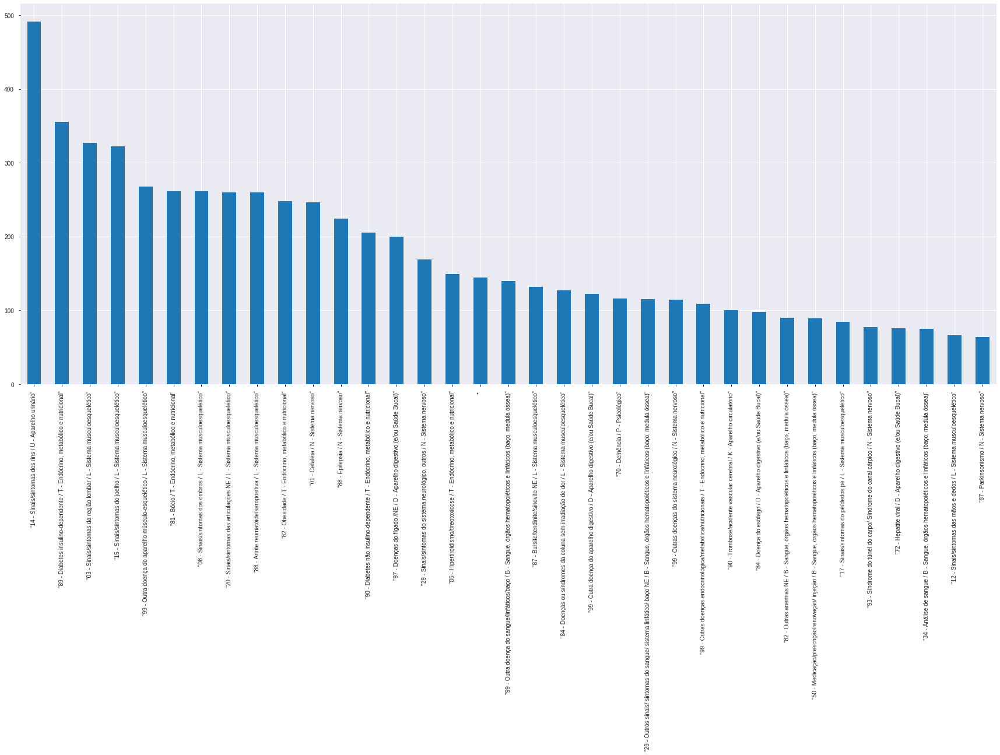

In [ ]:
histo_size = 35
# Sort values and create an histogram
histo2 = teleconsultorias_for_TFD['detalhamento'].value_counts()
# Truncate the series at histo_size:
if histo2.shape[0] > histo_size:
    histo_detalhamento = histo2.head(histo_size)
else:
    histo_detalhamento = histo2
fig = histo_detalhamento.plot(kind='bar', figsize=(60,22))
fig.figure.savefig(my_path+'teleconsultorias_for_TFD.detalhamento.png')
histo_detalhamento.plot(kind='bar', figsize=(30,12))
print('Number of values for \"detalhamento\" found: ', histo2.shape[0])
print('Listing of the ', histo_size, ' most frequent values for \"detalhamento\":')
histo_detalhamento

### Analise: *assunto*

Number of values found:  19524
Listing of the  35  most frequent values for "assunto":


"epilepsia"                      201
"plaquetopenia"                  200
"hipertireoidismo"               178
"artrite reumatoide"             172
"anemia"                         164
"encaminhamento"                 152
"cefaleia"                       127
"fibromialgia"                   104
"irc"                             97
"obesidade"                       96
"artrite reumatóide"              92
"lombalgia"                       86
"poliartralgia"                   77
"dor articular"                   76
"trombocitopenia"                 75
"leucopenia"                      65
"insuficiencia renal cronica"     65
"intenção de encaminhamento"      61
"hipotireoidismo"                 60
"hemocromatose"                   55
"pancitopenia"                    52
"curativo especial"               51
"doença renal crônica"            50
"nodulo tireoide"                 50
"insuficiencia renal"             49
"nódulo tireoidiano"              49
"artralgia"                       48
"

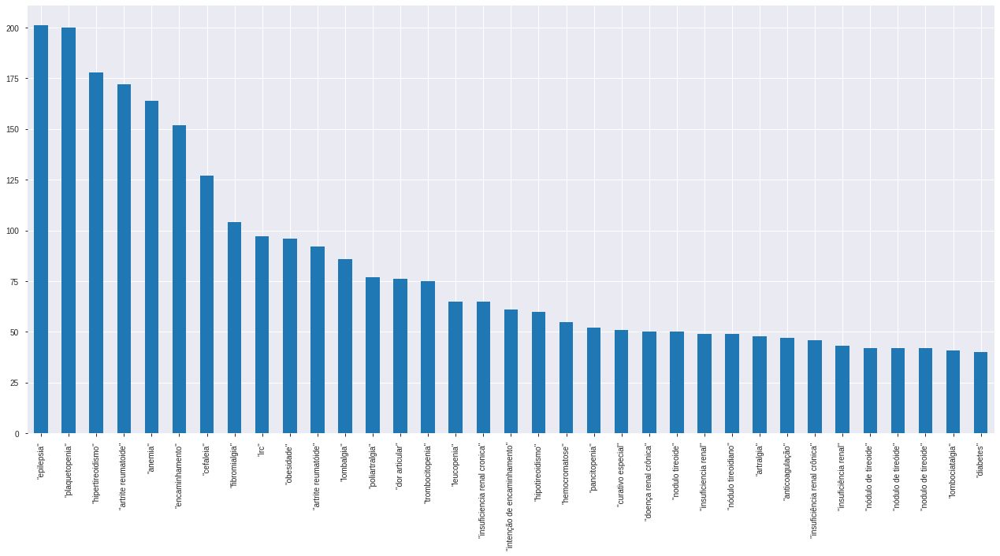

In [ ]:
histo_size = 35
# Sort values and create an histogram
histo4 = teleconsultorias_for_referral['assunto'].value_counts()
# Truncate the series at histo_size:
if histo4.shape[0] > histo_size:
    histo5 = histo4.head(histo_size)
else:
    histo5 = histo4
fig = histo5.plot(kind='bar', figsize=(35,20))
fig.figure.savefig(my_path+'teleconsultorias_for_referral.assunto.png')
histo5.plot(kind='bar', figsize=(22,10))
print('Number of values found: ', histo4.shape[0])
print('Listing of the ', histo_size, ' most frequent values for \"assunto\":')
histo5

### Analise: *especificacao*

256


"Ortopedia (Joinville; Jaraguá do Sul e região; Itajaí; Balneário Camboriú)"         2065
"Endocrinologia (Regulação Estadual; Joinville; Jaraguá do Sul e região; Itajaí)"    1486
"Neurologia Adulto (Regulação Estadual; Itajaí)"                                     1383
"Gastroenterologia Adulto (Regulação Estadual)"                                       913
"Reumatologia Adulto (Regulação Estadual; Itajaí; Balneário Camboriú)"                855
"Hematologia Adulto (Regulação Estadual)"                                             714
"Nefrologia Adulto (Regulação Estadual)"                                              669
"Nutrição (Jaraguá do Sul)"                                                           118
"Saúde Mental (Joinville)"                                                             71
"Obstetrícia (Joinville e região)"                                                     65
"Hanseníase (Regulação Estadual)"                                                       9
"Periodont

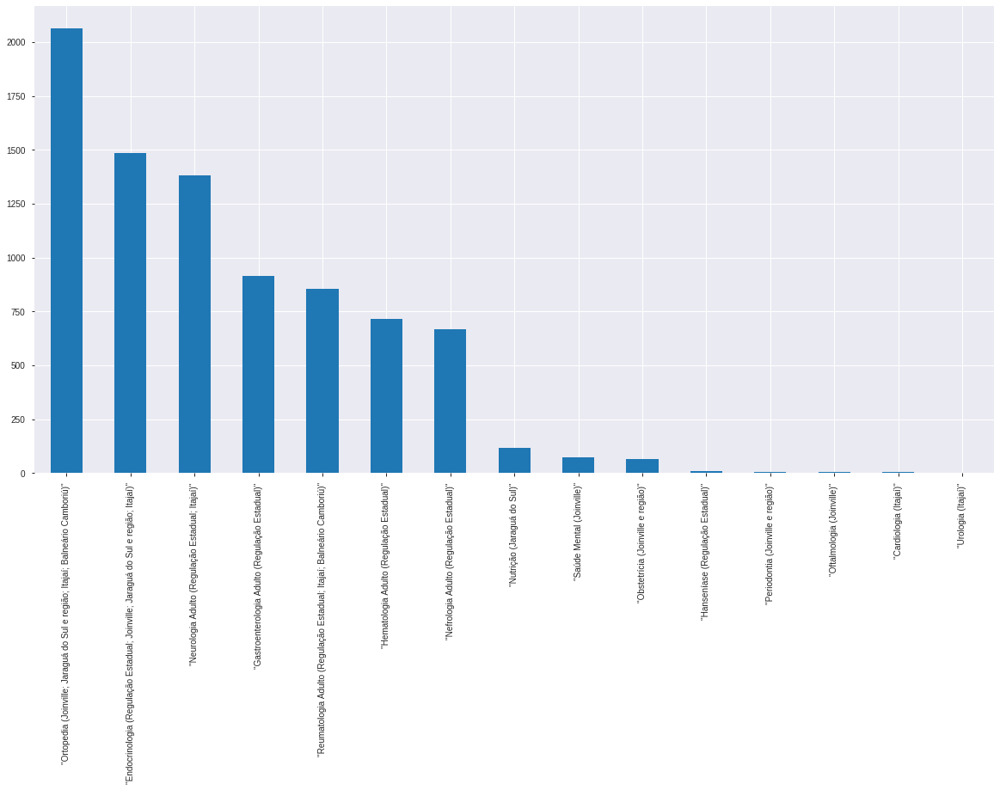

In [ ]:
# Sort values and create an histogram
histo3 = teleconsultorias_for_TFD['especificacao'].value_counts()
fig = histo3.plot(kind='bar', figsize=(30,22))
fig.figure.savefig(my_path+'teleconsultorias_for_TFD.especificacao.png')
histo3.plot(kind='bar', figsize=(20,10))
print(histo2.shape[0])
histo3.head(25)

### Timeframe

256


"Endocrinologia (Regulação Estadual; Joinville; Jaraguá do Sul e região; Itajaí)"    3164
"Ortopedia (Joinville; Jaraguá do Sul e região; Itajaí; Balneário Camboriú)"         2745
"Neurologia Adulto (Regulação Estadual; Itajaí)"                                     2684
"Hematologia Adulto (Regulação Estadual)"                                            2319
"Reumatologia Adulto (Regulação Estadual; Itajaí; Balneário Camboriú)"               1847
"Gastroenterologia Adulto (Regulação Estadual)"                                      1712
"Nefrologia Adulto (Regulação Estadual)"                                             1650
"Cuidado de Feridas (Joinville)"                                                      166
"Nutrição (Jaraguá do Sul)"                                                           111
"Saúde Mental (Joinville)"                                                            101
"Hanseníase (Regulação Estadual)"                                                      88
"Periodont

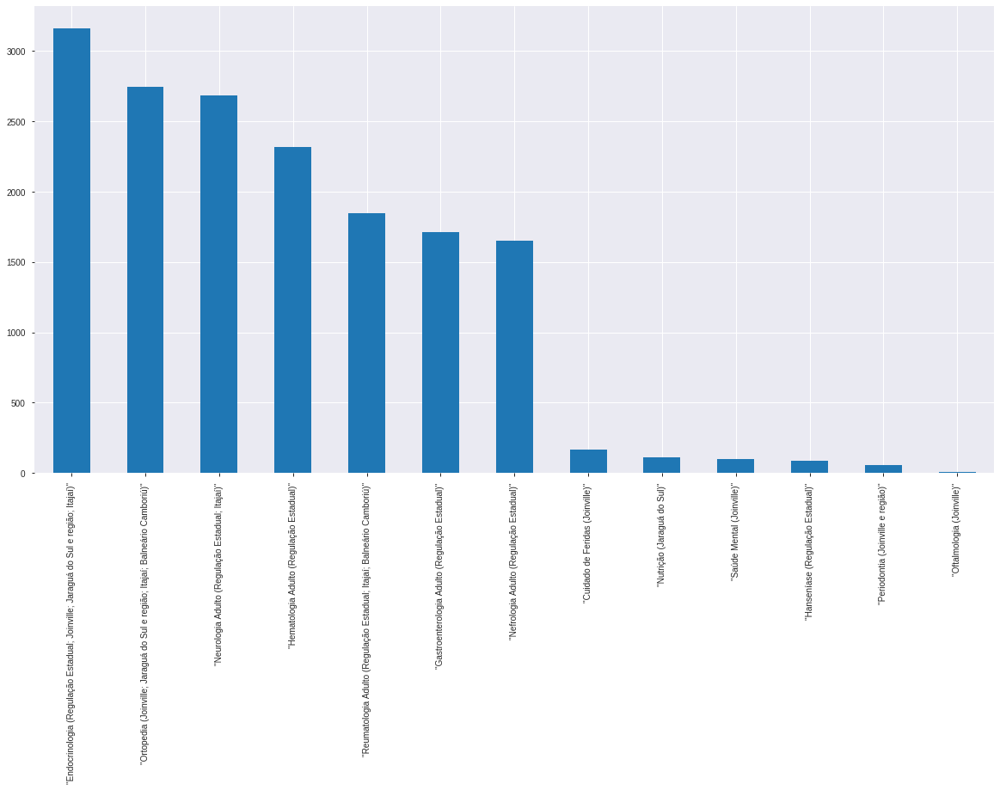

In [ ]:
# Sort values and create an histogram
histo3 = teleconsultorias_for_referral_timeframe['especificacao'].value_counts()
fig = histo3.plot(kind='bar', figsize=(30,22))
fig.figure.savefig(my_path+'teleconsultorias_for_referral_timeframe.especificacao.png')
histo3.plot(kind='bar', figsize=(20,10))
print(histo2.shape[0])
histo3.head(25)

In [ ]:
# Generate a profile report.
# This time, only where the patient was explicitly referred
profile_teleconsultorias_for_TFD = teleconsultorias_for_TFD.profile_report(style={'full_width':True},
                                                          n_freq_table_max = 20,
                                                          title='Profile Report of the Teleconsulting Cases Suggested for Referral')
profile_teleconsultorias_for_TFD.to_file(output_file=my_path + "profile_teleconsultorias_for_TFD.html")
profile_teleconsultorias_for_TFD

## Text Mining & NLP

### Text Mining & NLP Help Functions

In [ ]:
# Concatenates text fields and prepares text

def concat_text_fields(dataframe, column):
    # print(column)
    concat_text = ''
    # Traverse the dataframe and replace 'especificacao' by 'Other' every
    # time the count is less than the cut percentile
    for t in dataframe.index:
        concat_text = concat_text + dataframe.loc[t, column]
    # Transform HTML text into UTF-8
    concat_text = BeautifulSoup(concat_text)
    # Extract plain text from the bsp4 object
    concat_text = concat_text.get_text()
    return concat_text


def tokenize_text(concat_text, sentence=False):
    # Quebra em palavras ou sentenças
    if sentence:
        tokenized_text=sent_tokenize(concat_text)
    else:
        tokenized_text=word_tokenize(concat_text)
    # All lowercase
    tokenized_text2 = [w.lower() for w in tokenized_text]
    # New token list
    tokenized_text3=[]
    for w in tokenized_text2:
        # Eliminate stop words
        if w not in stop_words:
            # Eliminate 1-character words
            if len(w) > 1:
                tokenized_text3.append(w)
    return tokenized_text3

### Most frequent words in 'assunto'

In [ ]:
concat_text_pergunta = concat_text_fields(teleconsultorias_for_referral, 'pergunta')
tokenized_text_pergunta = tokenize_text(concat_text_pergunta)

### Most frequent words in 'pergunta'

In [ ]:
concat_text_pergunta = concat_text_fields(teleconsultorias_for_referral, 'pergunta')
tokenized_text_pergunta = tokenize_text(concat_text_pergunta)

In [ ]:
fdist_pergunta = FreqDist(tokenized_text_pergunta)
fdist_pergunta.most_common(30)

[('paciente', 17174),
 ('dor', 5431),
 ('anos', 4771),
 ('encaminhamento', 4695),
 ('avaliação', 4491),
 ('uso', 4358),
 ('acompanhamento', 3758),
 ('exames', 3379),
 ('tratamento', 3179),
 ('quadro', 2676),
 ('solicito', 2348),
 ('apresenta', 2117),
 ('refere', 2113),
 ('exame', 2044),
 ('consulta', 1981),
 ('necessidade', 1937),
 ('dia', 1931),
 ('conduta', 1850),
 ('devido', 1835),
 ('direito', 1826),
 ('meses', 1810),
 ('encaminhar', 1737),
 ('especialista', 1613),
 ('apresentando', 1476),
 ('esquerdo', 1440),
 ('mg', 1393),
 ('melhora', 1392),
 ('investigação', 1369),
 ('caso', 1325),
 ('renal', 1323)]

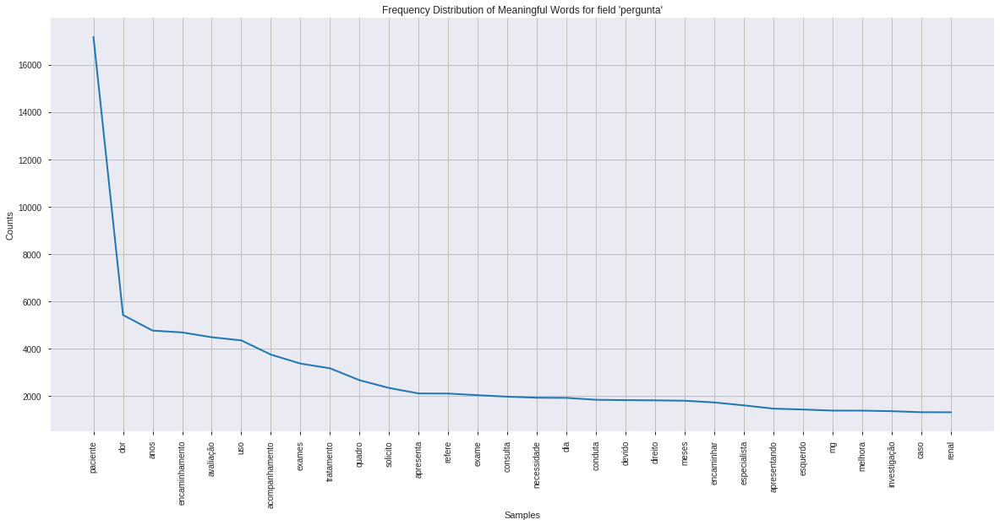

In [ ]:
plt.figure(figsize=(20,9))
fdist_pergunta.plot(30,cumulative=False, title='Frequency Distribution of Meaningful Words for field \'pergunta\'')

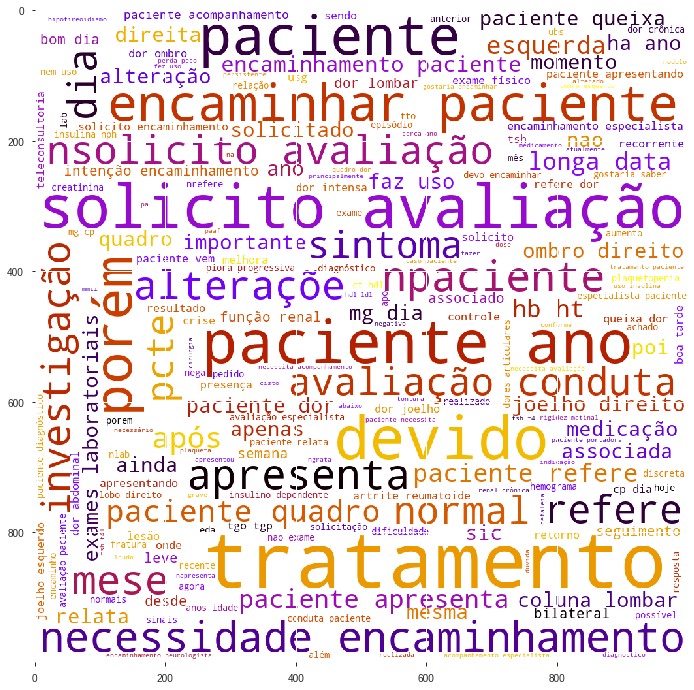

In [ ]:
wc = WordCloud(width = 1000, height = 1000,
               #colormap = 'tab20',
               colormap = 'gnuplot',
               background_color = 'white')
img = wc.generate_from_text(' '.join(tokenized_text_pergunta))
img.to_file(my_path + 'wordcloud_pergunta.png')
plt.figure(figsize=(12,12))
plt.imshow(img)

### Most frequent words in 'assunto'

In [ ]:
concat_text = concat_text_fields(teleconsultorias_for_referral, 'assunto')
tokenized_text = tokenize_text(concat_text)

In [ ]:
fdist = FreqDist(tokenized_text)
fdist.most_common(30)

[('paciente', 2137),
 ('dor', 1352),
 ('encaminhamento', 1125),
 ('renal', 968),
 ('anemia', 867),
 ('crônica', 749),
 ('artrite', 614),
 ('dm', 610),
 ('doença', 587),
 ('tireoide', 533),
 ('anos', 511),
 ('joelho', 510),
 ('avaliação', 495),
 ('cronica', 494),
 ('nódulo', 451),
 ('cefaleia', 432),
 ('plaquetopenia', 427),
 ('diabetes', 407),
 ('alteração', 403),
 ('maria', 402),
 ('ombro', 382),
 ('epilepsia', 375),
 ('acompanhamento', 369),
 ('obesidade', 361),
 ('reumatoide', 356),
 ('direito', 347),
 ('lombar', 331),
 ('silva', 321),
 ('cisto', 318),
 ('tratamento', 305)]

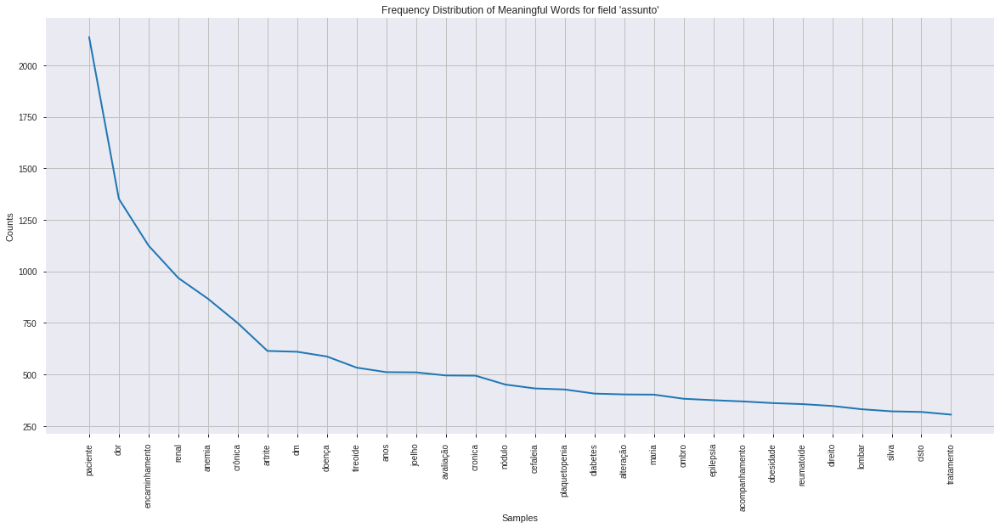

In [ ]:
plt.figure(figsize=(20,9))
fdist.plot(30,cumulative=False, title='Frequency Distribution of Meaningful Words for field \'assunto\'')

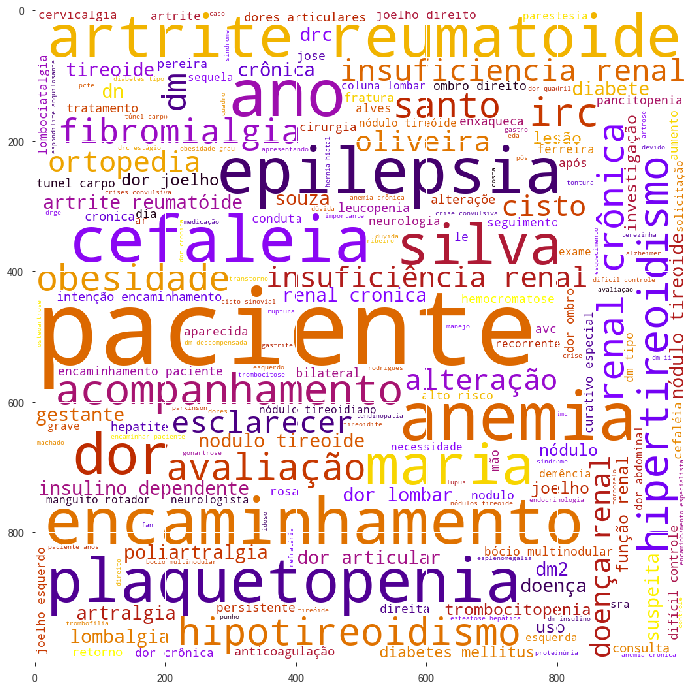

In [ ]:
wc = WordCloud(width = 1000, height = 1000,
               #colormap = 'tab20',
               colormap = 'gnuplot',
               background_color = 'white')
img = wc.generate_from_text(' '.join(tokenized_text))
img.to_file(my_path + 'wordcloud_assunto.png')
plt.figure(figsize=(12,12))
plt.imshow(img)

### Most frequent words in 'resposta'

In [ ]:
concat_text_resposta = concat_text_fields(teleconsultorias_for_referral, 'resposta')
tokenized_text_resposta = tokenize_text(concat_text_resposta)

In [ ]:
fdist_resposta = FreqDist(tokenized_text_resposta)
fdist_resposta.most_common(30)

[('paciente', 24719),
 ('ser', 20512),
 ('pode', 11873),
 ('tratamento', 10406),
 ('doença', 10151),
 ('avaliação', 8906),
 ('pacientes', 8481),
 ('diagnóstico', 7337),
 ('sintomas', 7108),
 ('exames', 6657),
 ('uso', 6600),
 ('dia', 6588),
 ('caso', 6416),
 ('sugiro', 6049),
 ('hepática', 5995),
 ('dor', 5793),
 ('solicitar', 5651),
 ('deve', 5573),
 ('encaminhamento', 5271),
 ('consulta', 5021),
 ('mg', 4725),
 ('podem', 4701),
 ('exame', 4699),
 ('encaminhar', 4601),
 ('crônica', 4394),
 ('risco', 4272),
 ('prezado', 4227),
 ('devem', 3924),
 ('dose', 3705),
 ('quadro', 3650)]

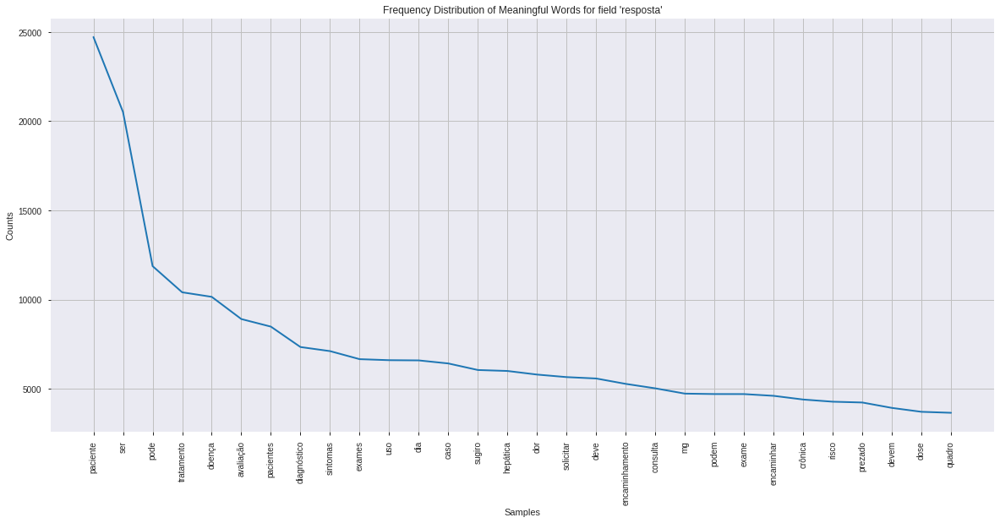

In [ ]:
plt.figure(figsize=(20,9))
fdist_resposta.plot(30,cumulative=False, title='Frequency Distribution of Meaningful Words for field \'resposta\'')

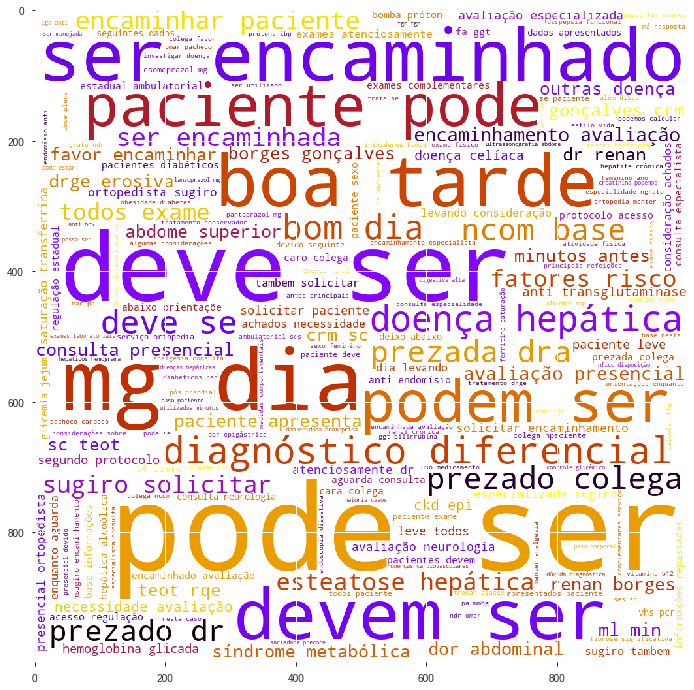

In [ ]:
wc = WordCloud(width = 1000, height = 1000,
               #colormap = 'tab20',
               colormap = 'gnuplot',
               background_color = 'white')
img = wc.generate_from_text(' '.join(tokenized_text_resposta))
img.to_file(my_path + 'wordcloud_resposta.png')
plt.figure(figsize=(12,12))
plt.imshow(img)

### Most *salient* sentences in 'pergunta'

These are sentences that:
* contain words that appear often

In [ ]:
concat_sentences_text = concat_text_fields(teleconsultorias_for_referral, 'pergunta')
tokenized_sentences_text = tokenize_text(concat_sentences_text, sentence=True)

tokenized_text = tokenize_text(concat_sentences_text, sentence=False)

In [ ]:
tokenized_sentences_text

['"diabetes insulino-dependente não controlada ""dor e limitação funcional ipotante em ambos quadris.""',
 '\\nsolicito orientação sobre a necessidade de realizar outros exames complementares.',
 'pte encaminhado ao urologista, e exs sorologicos p/ hepatites solicitados.\\natenciosamente\\nlucia brasil""conduta da paciente .',
 '""paciente com 75 anos de idade, com queixa de dor persistente em pé direito, forte intensidade, pior à noite desde meados de out/2016, após torção em escada.',
 'na ocasião procurou ps, realizado rx, sem alterações.\\nmas não teve melhora do quadro com tratamento conservador, mesmo já feito uso de tala e fisioterapia - 30 sessões.\\nhp: cirurgia por ruptura de tendão em pé esquerdo (2010) com dr kim.\\nao exame: dor à deambulação, flexão e extensão, com discreta edema em região dorsal de pé direito.\\nusg de 26/06/2018: sem alterações.\\nprescrevo pregabalina 75mg/dia e oriento alongamento.\\nencaminho para avaliação e conduta da ortopedia.',
 '""solicito auto

In [ ]:
important_sentences = defaultdict(int)

text_without_stopwords = [word for word in concat_sentences_text if word not in stop_words]

frequency = FreqDist(text_without_stopwords)

# Hora de popular o nosso dicionário.
# Vamos criar um looping para percorrer todas as sentenças e coletar todas as estatísticas:
for i, sentence in enumerate(tokenized_sentences_text):
    for word in word_tokenize(sentence.lower()):
        if word in frequency:
            important_sentences[i] += frequency[word]

important_sentences

defaultdict(int,
            {13: 54554,
             15: 74432,
             28: 37216,
             34: 25954,
             35: 10267,
             38: 13824,
             39: 9937,
             46: 13453,
             59: 37216,
             79: 9937,
             82: 57166,
             90: 1758,
             91: 37216,
             98: 13824,
             108: 37216,
             116: 15597,
             117: 37216,
             124: 37216,
             134: 13034,
             138: 50669,
             140: 475680,
             148: 25954,
             150: 383910,
             151: 230705,
             159: 13034,
             162: 13824,
             176: 237840,
             180: 237840,
             182: 25954,
             184: 37216,
             185: 24091,
             187: 263794,
             190: 25954,
             200: 512896,
             206: 1102413,
             208: 237840,
             217: 13824,
             220: 52716,
             223: 51908,
             22

In [ ]:
idx_sentencas_importantes = nlargest(8, important_sentences, important_sentences.get)

for i in sorted(idx_sentencas_importantes):
    print(text_color.BLUE, text_color.BOLD, i, ':', text_color.END, tokenized_sentences_text[i], '\n')

  7160 :  traz resultado de exames do ano passado e prescrição de 2016. exames de 29/05/2017: he 4,95 hb 14,5 ht 43,8 leuc 7000 s 58,7 e 3,0 l 32,5 m 5,8 plaq 298000 vhs 18 g 97 u 38 c 0,60 fa 64 tgo 19 tgp 18 gama gt 101 fr 518 pcr 3,43 equ ácido úrico + eletroforese de proteínas; - proteínas totais 6,98 - albumina 3,86 - alfa 1 globulina 0,08 - alfa 2 globulina 0,82 - beta 1 globulina 0,54 - beta 2 globulina 0,41 - gama globulina 1,27 - relação a/g 1,24 * radiografia da mão direita e esquerda 04/04/2017: alterações degenerativas nas interfalanges distais bilaterais e nos primeiros metacarpofalanges, relacionadas a reduções dos espaços articulares e osteófitos marginais. 

  9262 :  comorbidades: has tratamentos em uso/andamento: raloxifeno 60mg resultados dos exames realizados exames de imagem: densitometria óssea (04/10/2018): coluna lombar: t score -4,1 e fêmur t score - 3,2 e -2,7 (perda de 3,2% de massa óssea no fêmur comparado com exame anterior) densitometria óssea (30/06/2016)

### Teleconsulting Cases Explicitly Indicated not to be Referred

In [ ]:
# Create a copy of the 'teleconsultorias' dataframe with the entries where teleconsultor_sugeriu_encaminhamento == '"Não"'
teleconsultorias_not_for_TFD = teleconsultorias[teleconsultorias.teleconsultor_sugeriu_encaminhamento == '\"Não\"']
print('Number of entries: ', teleconsultorias_not_for_TFD.shape)
teleconsultorias_not_for_TFD.head(15)

Number of entries:  (4162, 20)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,detalhamento,pergunta,data_resposta,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria
8,46698,"""Assíncrona""","""2018-08-21 16:45:13.410178""",1495079,,"""898.0029.2391.2952""","""LETICIA APARECIDA GONÇALVES DE CASTRO MESNERO...","""Enxaqueca com aura / cisto pineal""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""","""89 - Enxaqueca / N - Sistema nervoso""","""Qual a conduta para cisto pineal evoluindo co...","""2018-08-24 10:42:17.027138""","""""","""Prezado Dr. Bruno.\n\nCistos pineais assintom...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não"""
13,46703,"""Assíncrona""","""2018-08-21 16:57:15.162946""",1495112,,"""704206261684184""","""MAISA DOEGE""","""PROFILAXIA FEBRE REUMÁTICA""","""Dúvidas clínicas gerais""","""K - Aparelho circulatório""","""99 - Outras doenças do aparelho circulatório""","""PACIENTE TEVE FEBRE REUMÁTICA AOS 5 ANOS E DE...","""2018-08-23 09:36:01.010936""","""""","""A duração da profilaxia depende da idade do p...","""Insatisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Não se aplica"""
18,46708,"""Assíncrona""","""2018-08-21 17:07:52.84992""",1495142,,"""700605953111761""","""ANDERSON ALIRIO DE OLIVEIRA ""","""ANDERSON ALIRIO DE OLIVEIRA 35 anos ""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""","""28 - Limitação funcional/incapacidade / N - S...","""Masculino 35 anos \n\n#Visita domiciliar \nAc...","""2018-08-24 10:58:23.077422""","""""","""Prezada Dra. Tuiane""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Não""","""Não""","""Sim"""
19,46709,"""Assíncrona""","""2018-08-21 17:18:12.435995""",1495146,,"""801440452672363""","""ANDREZA RIBEIRO DE SANTANA""","""Crise convulsiva""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Neurologia Adulto (Regulação Estadual; Itajaí)""","""07 - Convulsões/ataques / N - Sistema nervoso""","""Crise convulsiva ""","""2018-08-24 10:59:08.988913""","""""","""Prezada Dra. Mayara.""","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não"""
29,46719,"""Assíncrona""","""2018-08-21 17:29:59.834991""",1495241,8700689971,"""898002382840929""","""IDALICIO PALHARES NETO""","""Tendinopatia do Tendão Tibial Posterior""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Ortopedia (Joinville; Jaraguá do Sul e região...","""87 - Bursite/tendinite/sinovite NE / L - Sist...","""Tendinopatía do Tendão Tibial Posterior""","""2018-08-28 01:44:31.405644""","""""","""Prezado colega, paciente com lesão crônica do...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não"""
32,46724,"""Assíncrona""","""2018-08-21 22:57:44.445695""",1495286,,"""707805651499517""","""MARLETE APARECIDA DA SILVA BARBOSA""","""Eructação noturna há 1 ano e meio""","""Dúvidas clínicas sobre pacientes (Intenção de...","""Gastroenterologia Adulto (Regulação Estadual)""","""29 - Outros sinais/sintomas digestivos / D - ...","""Qual seria a causa dos episódios de eructação...","""2018-08-23 19:04:03.342182""","""R14 - Flatulência e afecções correlatas""","""\tTrata-se de paciente com H pylori positivo,...","""Satisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Sim"""
48,46745,"""Assíncrona""","""2018-08-22 11:09:53.61748""",1495736,65753607934,"""""","""CECILIA ANTONIA DA LUZ SAIDOK""","""hipotireoidismo""","""Dúvidas clínicas gerais""","""T - Endócrino, metabólico e nutricional""","""86 - Hipotiroidismo/mixedema""","""HIPOTIREOIDISMO . DÚVIDA_ AJUSTE DA DOSE DO ...","""2018-08-29 09:33:22.369569""","""E03 - Outros hipotireoidismos""","""Bom dia Cezar. \nPelo que entendi, ela está u...","""Muito satisf

In [ ]:
# Generate a profile report.
# This time, only with the patient was explicitly declared not to be referred
profile_teleconsultorias_not_for_TFD = teleconsultorias_not_for_TFD.profile_report(style={'full_width':True},
                                                          n_freq_table_max = 20,
                                                          title='Profile Report of the Teleconsulting Cases Explicitly Suggested NOT for Referral')
profile_teleconsultorias_not_for_TFD.to_file(output_file=my_path + "profile_teleconsultorias_not_for_TFD.html")
profile_teleconsultorias_not_for_TFD

## Generic Teleconsultations



In [ ]:
# Create a copy of the 'teleconsultorias' dataframe with the entries where classificacao = "Dúvidas clínicas sobre pacientes (Intenção de encaminhamento – Fluxos com Centrais de Regulação)"
teleconsultorias_general_questions = teleconsultorias[teleconsultorias.classificacao == '\"Dúvidas clínicas gerais\"']
print('Number of entries: ', teleconsultorias_general_questions.shape)
teleconsultorias_general_questions.head(10)

Number of entries:  (2422, 20)


,id_teleconsultoria,tipo,data_solicitacao,id_int_paciente,cpf_paciente,cns_paciente,nome_paciente,assunto,classificacao,especificacao,detalhamento,pergunta,data_resposta,cid10,resposta,satisfacao_geral,atendimento_duvida_principal,evitou_encaminhamento,teleconsultor_sugeriu_encaminhamento,intencao_encaminhar_paciente_apos_teleconsultoria
0,46682,"""Assíncrona""","""2018-08-21 14:30:39.826752""",1494912,,"""705202483909977""","""MARIA SOUZA DOS SANTOS""","""curativo maria souza santos ""","""Dúvidas clínicas gerais""","""S - Pele""","""56 - Curativo/bandagem/compressão/tamponamento""","""em anexo \nCURATIVO MARIA SOUZA SANTOS""","""2018-08-28 17:13:11.366449""","""""","""Boa tarde Enfª Michely, \n\n\n\nAnexo requisi...","""""","""""","""""","""""",""""""
13,46703,"""Assíncrona""","""2018-08-21 16:57:15.162946""",1495112,,"""704206261684184""","""MAISA DOEGE""","""PROFILAXIA FEBRE REUMÁTICA""","""Dúvidas clínicas gerais""","""K - Aparelho circulatório""","""99 - Outras doenças do aparelho circulatório""","""PACIENTE TEVE FEBRE REUMÁTICA AOS 5 ANOS E DE...","""2018-08-23 09:36:01.010936""","""""","""A duração da profilaxia depende da idade do p...","""Insatisfeito(a)""","""Atendeu parcialmente""","""Não se aplica""","""Não""","""Não se aplica"""
21,46711,"""Assíncrona""","""2018-08-21 17:20:15.210146""",1495160,,"""898005813495837""","""CAMILA VIANA""","""alergia a ovo""","""Dúvidas clínicas gerais""","""A - Geral e não-específico""","""92 - Alergia/reação alérgica NE""","""Criança com 10 meses, refere episodio de aler...","""2018-08-28 15:52:30.744214""","""""","""Thalia, por ser cultivada em ovos embrionados...","""Satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Não se aplica""","""Não se aplica"""
37,46732,"""Assíncrona""","""2018-08-22 08:53:16.133503""",1495296,,"""704105196333378""","""FERNANDA PEREIRA""","""GRAVIDEZ ECTÓPICA X ANTICONCEPCIONAL""","""Dúvidas clínicas gerais""","""W - Gravidez e planejamento familiar""","""80 - Gravidez ectópica""","""26 anos\n\n#CONSULTA MÉDICA\n\n#Tabagista 10c...","""2018-08-29 09:18:29.520922""","""""","""Raisa, o Ministério da Saúde preconiza que os...","""Satisfeito(a)""","""Atendeu totalmente""","""Não se aplica""","""Não se aplica""","""Não se aplica"""
42,46738,"""Assíncrona""","""2018-08-22 09:00:02.450435""",1495410,,"""161778218640004""","""CLARISSE DE FATIMA RIBEIRO""","""fistula arterio venosa""","""Dúvidas clínicas gerais""","""U - Aparelho urinário""","""67 - Referenciado para médico/especialista/cl...","""Se há necessidade de revisão e/ou acompanhame...","""2018-08-22 10:41:37.344882""","""""","""Prezado Colega\n\nA manutenção da FAV em paci...","""""","""""","""""","""""",""""""
48,46745,"""Assíncrona""","""2018-08-22 11:09:53.61748""",1495736,65753607934,"""""","""CECILIA ANTONIA DA LUZ SAIDOK""","""hipotireoidismo""","""Dúvidas clínicas gerais""","""T - Endócrino, metabólico e nutricional""","""86 - Hipotiroidismo/mixedema""","""HIPOTIREOIDISMO . DÚVIDA_ AJUSTE DA DOSE DO ...","""2018-08-29 09:33:22.369569""","""E03 - Outros hipotireoidismos""","""Bom dia Cezar. \nPelo que entendi, ela está u...","""Muito satisfeito(a)""","""Atendeu totalmente""","""Sim""","""Não""","""Não"""
50,46747,"""Assíncrona""","""2018-08-22 11:10:59.767487""",1495704,,"""708200666062445""","""JOSE BONIFÁCIO VELHO""","""curativo especial""","""Dúvidas clínicas gerais""","""A - Geral e não-específico""","""56 - Curativo/bandagem/compressão/tamponamento""","""HAS + DM + amputação MID. Em uso: Furosemida ...","""2018-08-29 15:04:13.08091""","""""","""Boa tarde Enfª Daniela, \n\n\nAnexo requisiçã...","""""","""""","""""","""""",""""""
52,46749,"""Assíncrona""","""2018-08-22 11:11:49.933866""",1495675,,"""701100010035410""","""ANA GORETTI SCHMIDT""","""curativo especial""","""Dúvidas clínicas gerais""","""A - Geral e não-específico""","""56 - Curativo/bandagem/compressão/tamponamento""","""#DM + HAS + hist de cirurgia em joelho D. Em ...","""2018-08-29 14:42:13.007087""","""""","""Boa t

256


"T - Endócrino, metabólico e nutricional"                                 425
"D - Aparelho digestivo (e/ou Saúde Bucal)"                               360
"B - Sangue, órgãos hematopoiéticos e linfáticos (baço, medula óssea)"    273
"L - Sistema musculoesquelético"                                          223
"N - Sistema nervoso"                                                     212
"S - Pele"                                                                183
"U - Aparelho urinário"                                                   167
"K - Aparelho circulatório"                                               165
"A - Geral e não-específico"                                              119
"R - Aparelho respiratório"                                                73
"P - Psicológico"                                                          60
"X - Aparelho genital feminino (incluindo mama)"                           50
"W - Gravidez e planejamento familiar"                          

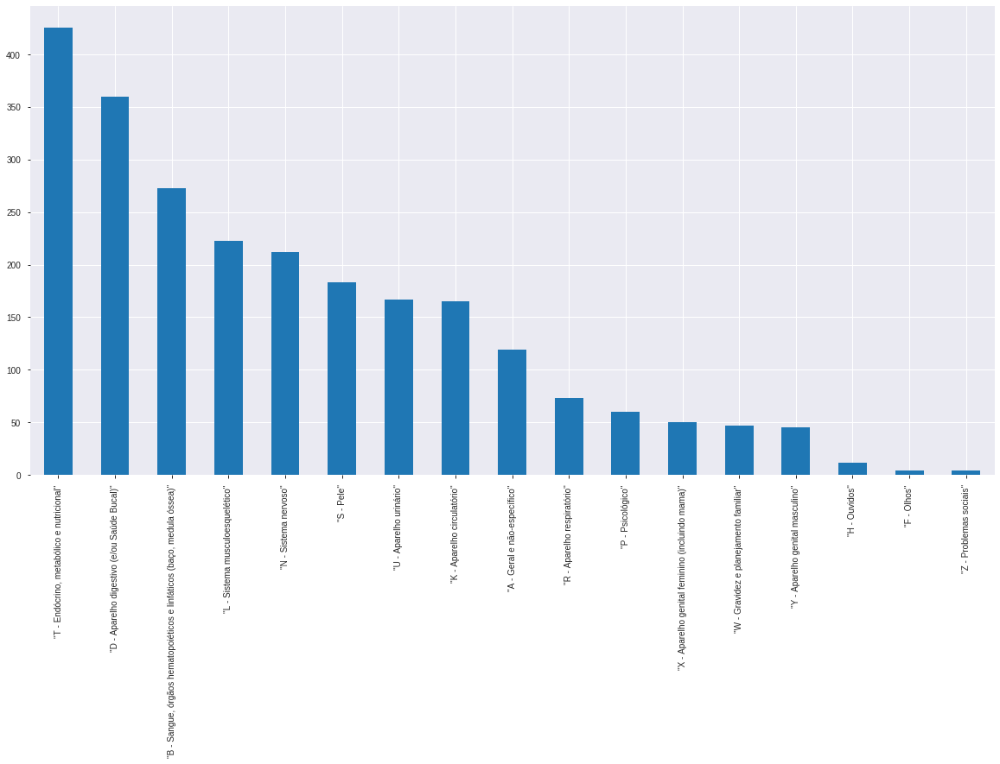

In [ ]:
# Sort values and create an histogram
histo3 = teleconsultorias_general_questions['especificacao'].value_counts()
fig = histo3.plot(kind='bar', figsize=(30,22))
fig.figure.savefig(my_path+'teleconsultorias_general_questions.especificacao.png')
histo3.plot(kind='bar', figsize=(20,10))
print(histo2.shape[0])
histo3.head(25)

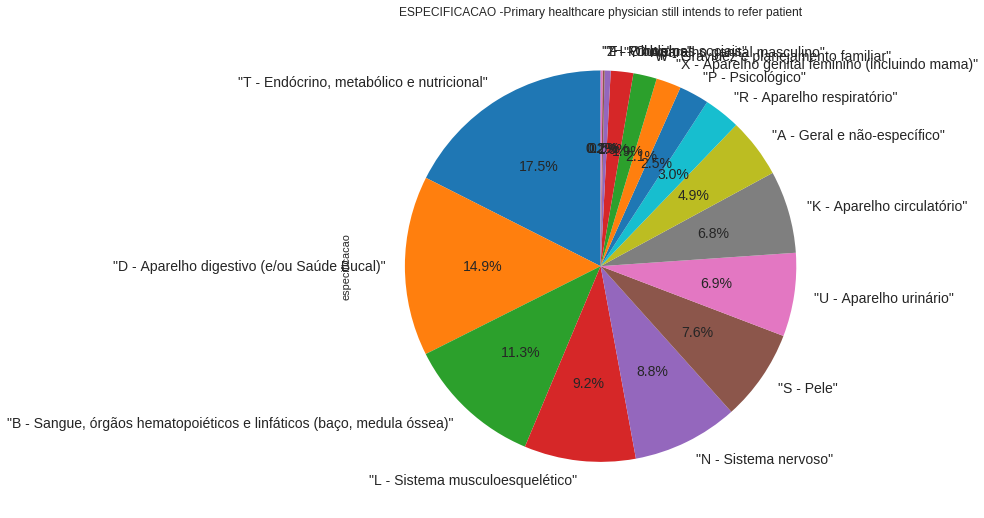

In [ ]:
plot = teleconsultorias_general_questions.especificacao.value_counts(sort=True).plot.pie(#y='intencao_encaminhar_paciente_apos_teleconsultoria',
                                                                                                            title='ESPECIFICACAO -Primary healthcare physician still intends to refer patient',
                                                                                                            # with the percent listed as a fraction
                                                                                                            autopct='%1.1f%%',
                                                                                                            fontsize=14,
                                                                                                            # with no shadows
                                                                                                            shadow=False,
                                                                                                            # with colors
                                                                                                            #colors=colors,
                                                                                                            # with the start angle at 90%
                                                                                                            startangle=90,
                                                                                                            # with one slide exploded out
                                                                                                            #explode=(0.1, 0, 0, 0.1),
                                                                                                            legend = False,
                                                                                                            figsize=(9, 9))

# Tests with Native Python CSV Routines

Pandas seems to be to high level to deal with some quirks in these Telehealth data. Let's try how easy it is with CSV and other native Python libraries.

In [ ]:
import csv

filename = '/home/awangenh/Documents/Pandas/Teleconsultorias3.csv'

with open(filename) as f:
    reader = csv.reader((line.replace('|@|', '|') for line in f), delimiter='|', quotechar='"')
    header_row = next(reader)
    for index,column_header in enumerate(header_row):
        print(index, column_header)

0 id_teleconsultoria
1 tipo
2 data_solicitacao
3 identificador_interno_paciente
4 cpf_paciente
5 cns_paciente
6 nome_paciente
7 assunto
8 classificacao
9 especificacao
10 detalhamento
11 pergunta
12 data_resposta
13 cid10
14 resposta
15 satisfacao_geral
16 atendimento_duvida_principal
17 evitou_encaminhamento
18 teleconsultor_sugeriu_encaminhamento
19 intencao_encaminhar_paciente_apos_teleconsultoria


# Credits/References

* [Medium::How to rewrite your SQL queries in Pandas, and more](https://medium.com/jbennetcodes/how-to-rewrite-your-sql-queries-in-pandas-and-more-149d341fc53e)
* [Towards Data Science::Exploring your data with just 1 line of Python](https://towardsdatascience.com/exploring-your-data-with-just-1-line-of-python-4b35ce21a82d)
* [Medium::Hacking Analytics::Become a Pro at Pandas, Python’s data manipulation Library](https://medium.com/analytics-and-data/become-a-pro-at-pandas-pythons-data-manipulation-library-264351b586b1)
* [Towards Data Science::10 Python Pandas tricks that make your work more efficient](https://towardsdatascience.com/10-python-pandas-tricks-that-make-your-work-more-efficient-2e8e483808ba)
* [Medium::Helpful Python Code Snippets for Data Exploration in Pandas](https://medium.com/@msalmon00/helpful-python-code-snippets-for-data-exploration-in-pandas-b7c5aed5ecb9)
* [Towards Data Science::23 great Pandas codes for Data Scientists](https://towardsdatascience.com/23-great-pandas-codes-for-data-scientists-cca5ed9d8a38)
* [Medium::Dunder Data::Minimally Sufficient Pandas](https://medium.com/dunder-data/minimally-sufficient-pandas-a8e67f2a2428)
* [Medium::Dunder Data::Selecting Subsets of Data in Pandas](https://medium.com/dunder-data/selecting-subsets-of-data-in-pandas-6fcd0170be9c)
* [**Medium Geral**::Search Pandas](https://medium.com/search?q=pandas)

### .csv and Delimiters

* [Pandas Cheat Sheet for Data Science in Python](https://www.datacamp.com/community/blog/python-pandas-cheat-sheet)

![banner cnns ppgcc ufsc](http://www.lapix.ufsc.br/wp-content/uploads/2019/04/CC-incod.png)
